In [1]:
import os

from tqdm import tqdm

import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np

from trainers import VAE_GAN_Trainer
from vae_gans import CIFAR_VAE_GAN
from utils import unpickle

os.environ["CUDA_VISIBLE_DEVICES"]="3"

datadir = './CIFAR10_data/'
batches = [datadir + batch for batch in os.listdir(datadir)]

/usr/local/lib/python3.5/dist-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
for i in tqdm(range(5)):
    batch = unpickle(batches[i])

    if i == 0:
        data = batch[b'data'].astype(np.float32)
        cifar = np.transpose(np.reshape(data, [-1,3,32,32]), [0,2,3,1])
        labels = batch[b'labels']
    else:
        data = batch[b'data'].astype(np.float32)
        cifar = np.concatenate((cifar, np.transpose(np.reshape(data, [-1,3,32,32]), [0,2,3,1])), axis=0)
        labels = np.concatenate((labels, batch[b'labels']), axis=0)

scaled_cifar = cifar / 127.5 - 1.0

test_batch = unpickle(batches[5])
cifar_test = np.transpose(np.reshape(test_batch[b'data'], [-1,3,32,32]), [0,2,3,1])
scaled_cifar_test = cifar_test / 127.5 - 1.0
labels_test = np.array(test_batch[b'labels'])

data_train = (scaled_cifar, labels)
data_test = (scaled_cifar_test, labels_test)

100%|██████████| 5/5 [00:02<00:00,  2.08it/s]


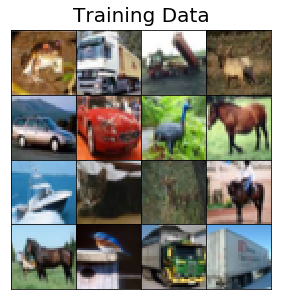

In [3]:
plt.figure(figsize=(4,4))
        
for i in range(16):
    
    image = (data_train[0][i] + 1) * 0.5

    plt.subplot(4, 4, i + 1)
    plt.imshow(image.reshape(32, 32, 3))
    plt.xticks([])
    plt.yticks([])

plt.suptitle('Training Data', fontsize=20, y=1.03)
plt.tight_layout()
plt.subplots_adjust(wspace=0.0, hspace=0.0)

plt.show()
plt.close()

Epoch : 1   | Enc Loss : 889.91223 | Dec Loss : 10.79138 | Disc Loss : 1.46219


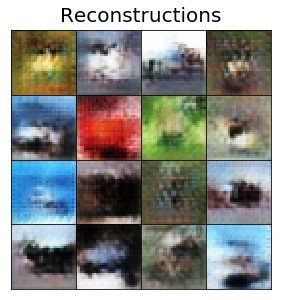

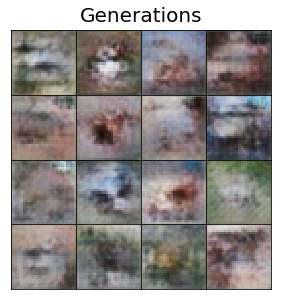

Epoch : 2   | Enc Loss : 757.90772 | Dec Loss : 9.31418 | Disc Loss : 1.64950


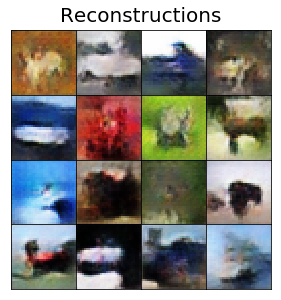

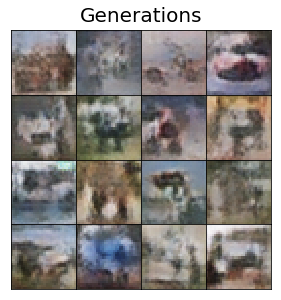

Epoch : 3   | Enc Loss : 723.93838 | Dec Loss : 8.95267 | Disc Loss : 1.69369


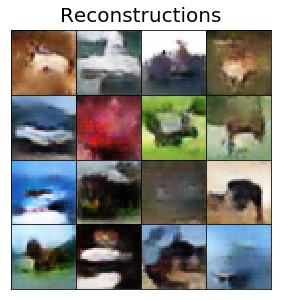

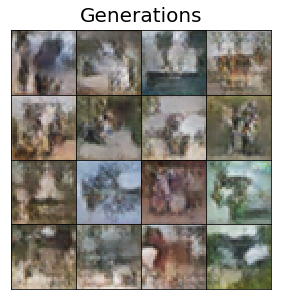

Epoch : 4   | Enc Loss : 699.30504 | Dec Loss : 8.66623 | Disc Loss : 1.69898


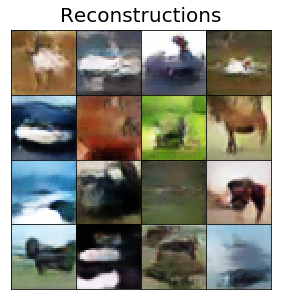

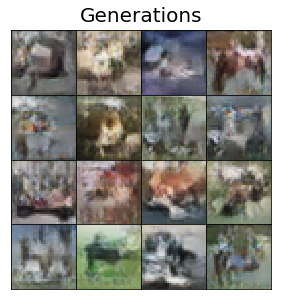

Epoch : 5   | Enc Loss : 680.02863 | Dec Loss : 8.41102 | Disc Loss : 1.69852


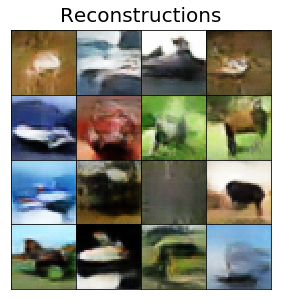

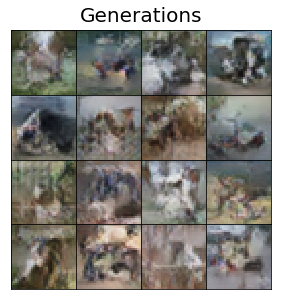

Epoch : 6   | Enc Loss : 665.40310 | Dec Loss : 8.23705 | Disc Loss : 1.69778


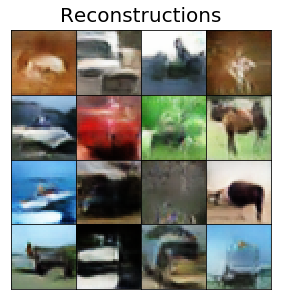

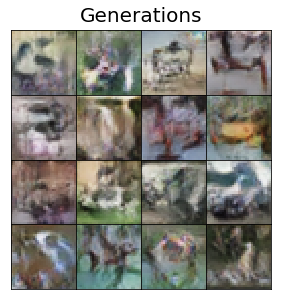

Epoch : 7   | Enc Loss : 652.37477 | Dec Loss : 8.07499 | Disc Loss : 1.69693


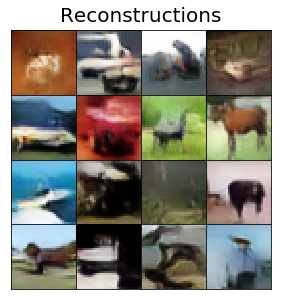

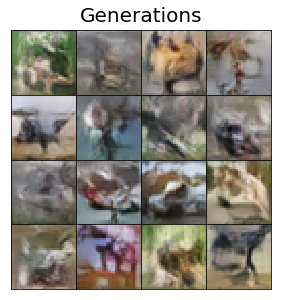

Epoch : 8   | Enc Loss : 641.33657 | Dec Loss : 7.95805 | Disc Loss : 1.69208


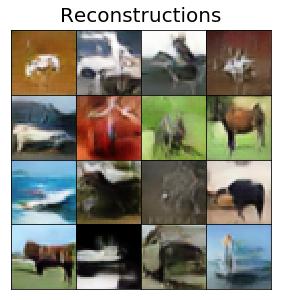

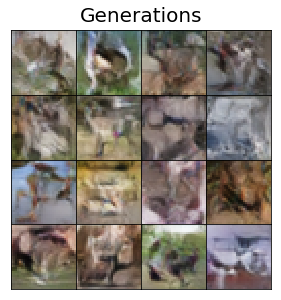

Epoch : 9   | Enc Loss : 631.97455 | Dec Loss : 7.84786 | Disc Loss : 1.68350


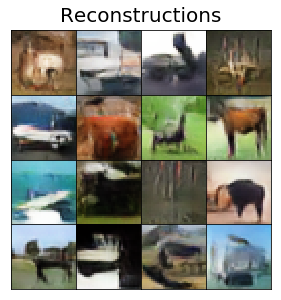

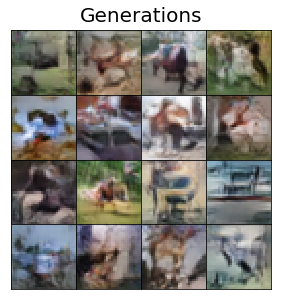

Epoch : 10  | Enc Loss : 625.28776 | Dec Loss : 7.78275 | Disc Loss : 1.68010


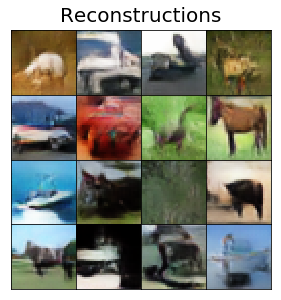

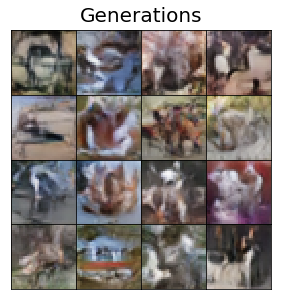

Epoch : 11  | Enc Loss : 620.03833 | Dec Loss : 7.75700 | Disc Loss : 1.67364


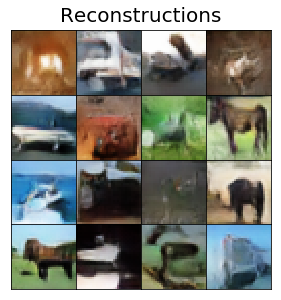

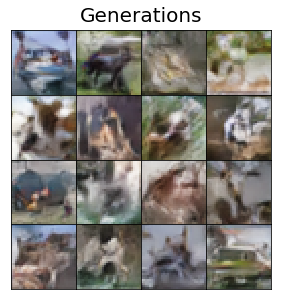

Epoch : 12  | Enc Loss : 616.02980 | Dec Loss : 7.69095 | Disc Loss : 1.66436


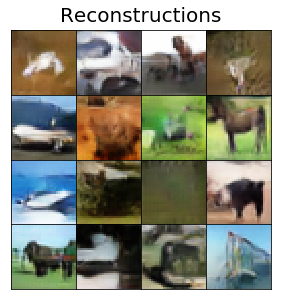

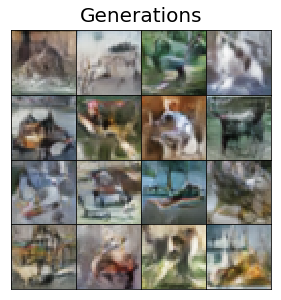

Epoch : 13  | Enc Loss : 612.30019 | Dec Loss : 7.65334 | Disc Loss : 1.65756


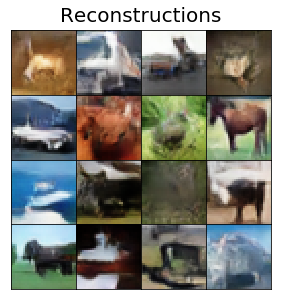

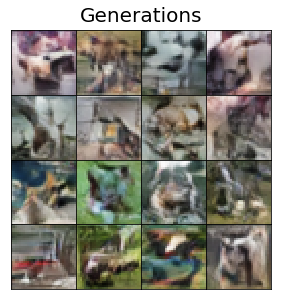

Epoch : 14  | Enc Loss : 607.91922 | Dec Loss : 7.59804 | Disc Loss : 1.65848


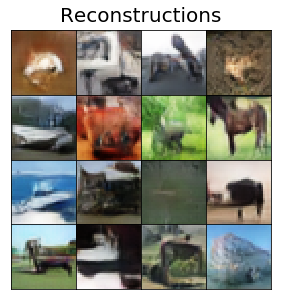

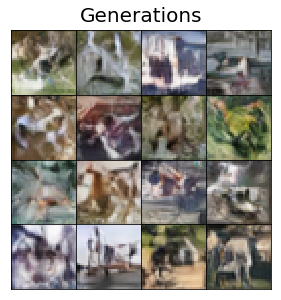

Epoch : 15  | Enc Loss : 605.82593 | Dec Loss : 7.58146 | Disc Loss : 1.64953


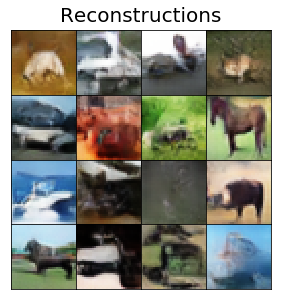

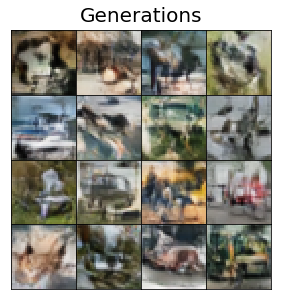

Epoch : 16  | Enc Loss : 603.63949 | Dec Loss : 7.51892 | Disc Loss : 1.65115


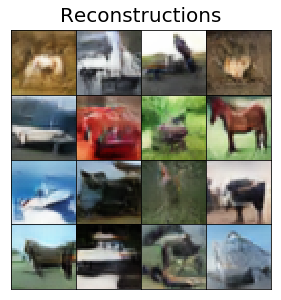

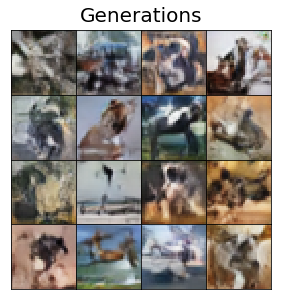

Epoch : 17  | Enc Loss : 601.88559 | Dec Loss : 7.48756 | Disc Loss : 1.64007


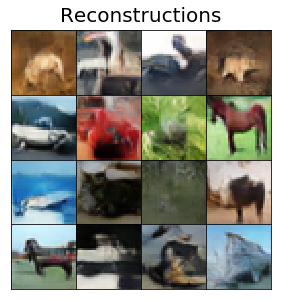

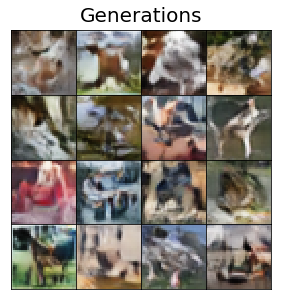

Epoch : 18  | Enc Loss : 599.30499 | Dec Loss : 7.47100 | Disc Loss : 1.63216


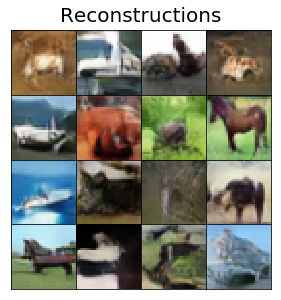

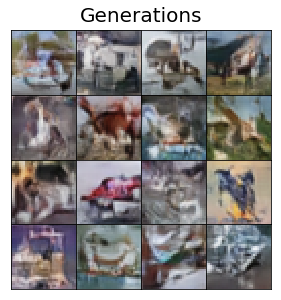

Epoch : 19  | Enc Loss : 598.21667 | Dec Loss : 7.48226 | Disc Loss : 1.62409


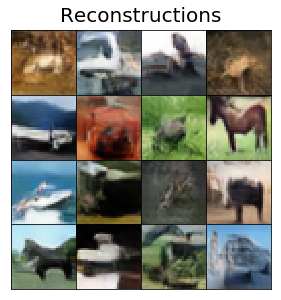

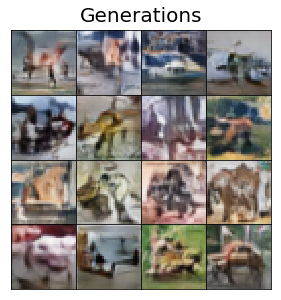

Epoch : 20  | Enc Loss : 598.41781 | Dec Loss : 7.43988 | Disc Loss : 1.61912


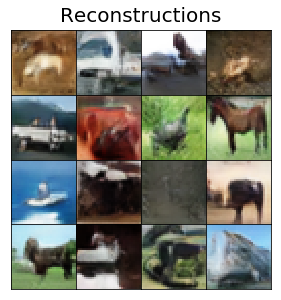

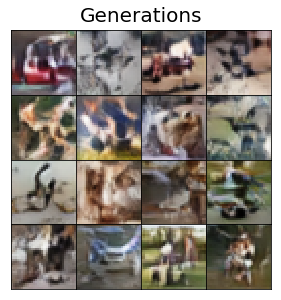

Epoch : 21  | Enc Loss : 597.27457 | Dec Loss : 7.45885 | Disc Loss : 1.61567


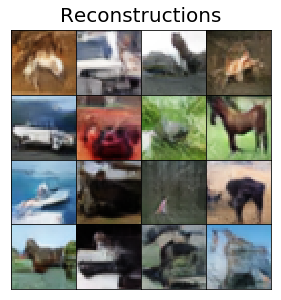

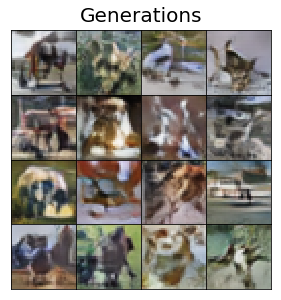

Epoch : 22  | Enc Loss : 598.59532 | Dec Loss : 7.45254 | Disc Loss : 1.60934


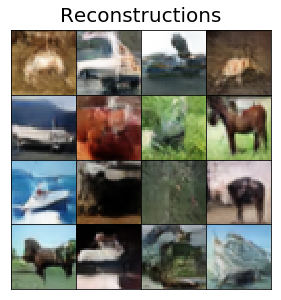

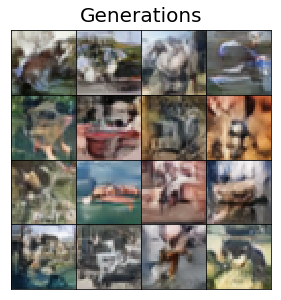

Epoch : 23  | Enc Loss : 597.55647 | Dec Loss : 7.42328 | Disc Loss : 1.60152


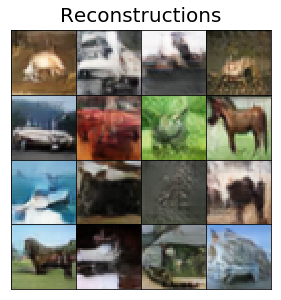

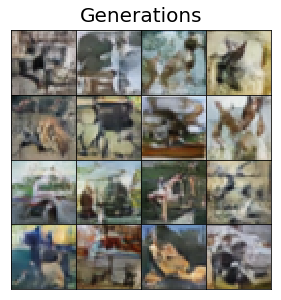

Epoch : 24  | Enc Loss : 595.94871 | Dec Loss : 7.39622 | Disc Loss : 1.59588


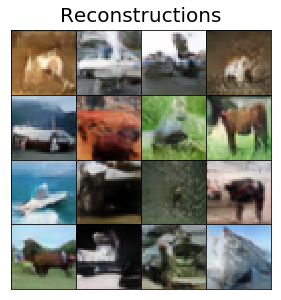

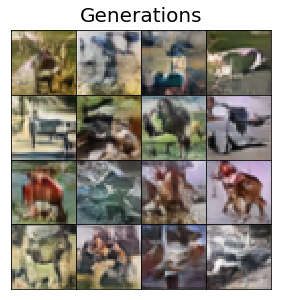

Epoch : 25  | Enc Loss : 595.92655 | Dec Loss : 7.41179 | Disc Loss : 1.59548


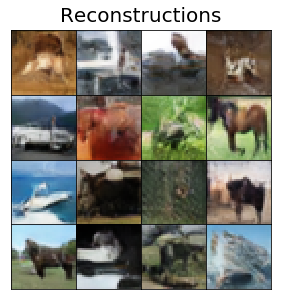

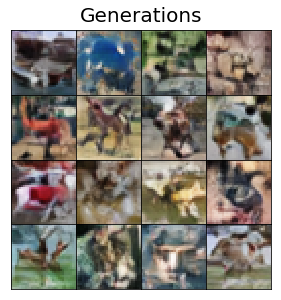

Epoch : 26  | Enc Loss : 594.50816 | Dec Loss : 7.41809 | Disc Loss : 1.59107


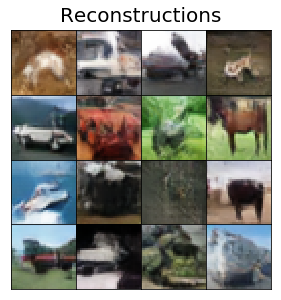

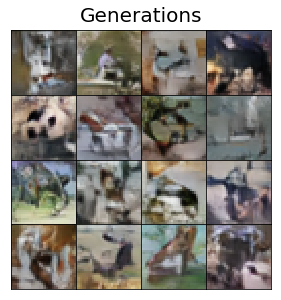

Epoch : 27  | Enc Loss : 595.21928 | Dec Loss : 7.43825 | Disc Loss : 1.58876


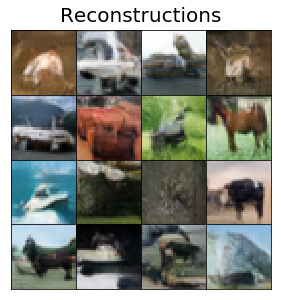

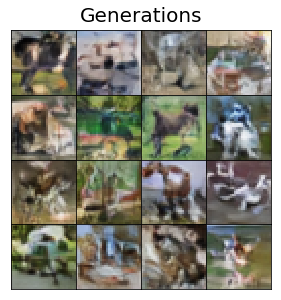

Epoch : 28  | Enc Loss : 595.34770 | Dec Loss : 7.40230 | Disc Loss : 1.58765


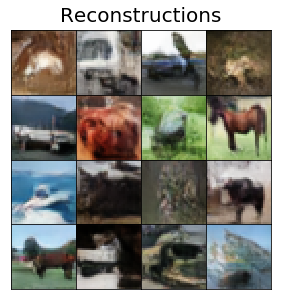

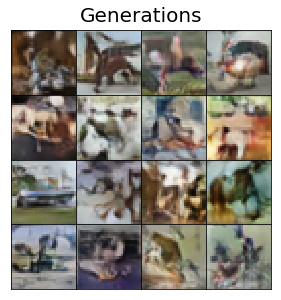

Epoch : 29  | Enc Loss : 595.04587 | Dec Loss : 7.38909 | Disc Loss : 1.58477


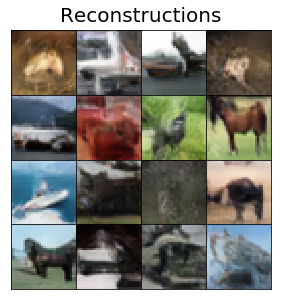

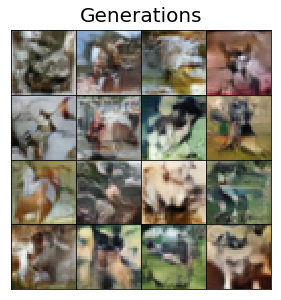

Epoch : 30  | Enc Loss : 593.61863 | Dec Loss : 7.39274 | Disc Loss : 1.58696


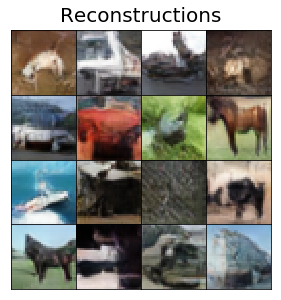

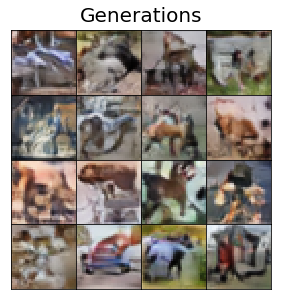

Epoch : 31  | Enc Loss : 592.62564 | Dec Loss : 7.37105 | Disc Loss : 1.58321


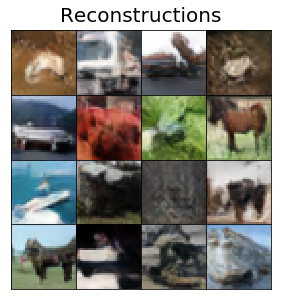

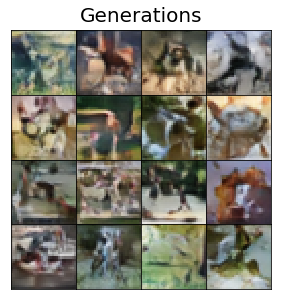

Epoch : 32  | Enc Loss : 592.72593 | Dec Loss : 7.38140 | Disc Loss : 1.58400


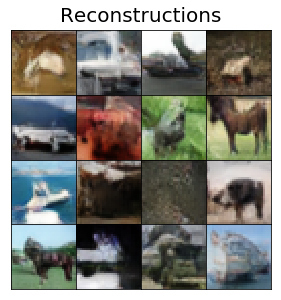

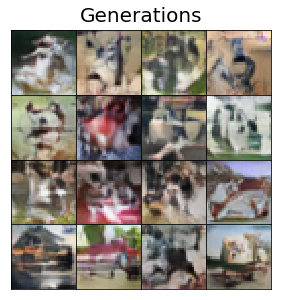

Epoch : 33  | Enc Loss : 592.18301 | Dec Loss : 7.37584 | Disc Loss : 1.58131


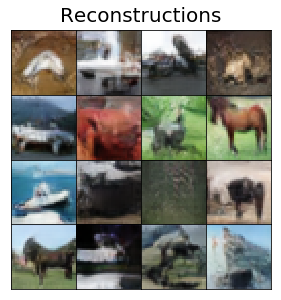

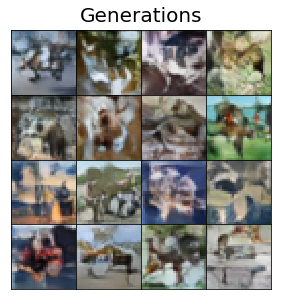

Epoch : 34  | Enc Loss : 592.45998 | Dec Loss : 7.32851 | Disc Loss : 1.57983


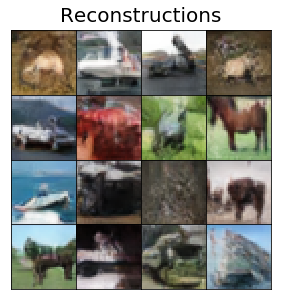

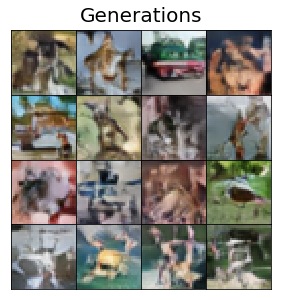

Epoch : 35  | Enc Loss : 591.19029 | Dec Loss : 7.33884 | Disc Loss : 1.57475


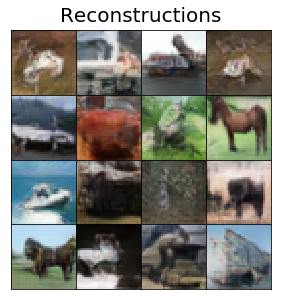

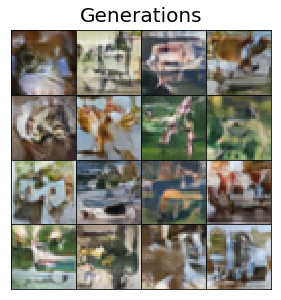

Epoch : 36  | Enc Loss : 590.77910 | Dec Loss : 7.37481 | Disc Loss : 1.58160


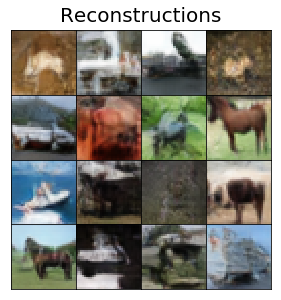

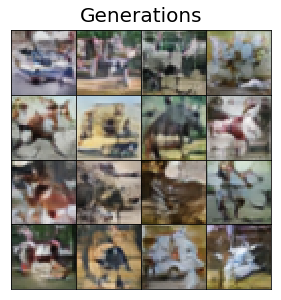

Epoch : 37  | Enc Loss : 589.97422 | Dec Loss : 7.39261 | Disc Loss : 1.57487


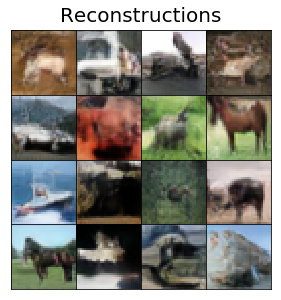

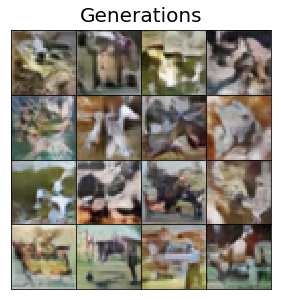

Epoch : 38  | Enc Loss : 588.32965 | Dec Loss : 7.29526 | Disc Loss : 1.57473


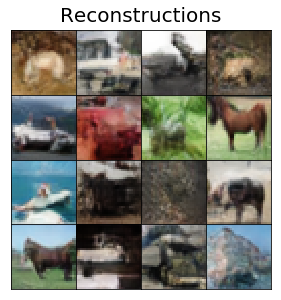

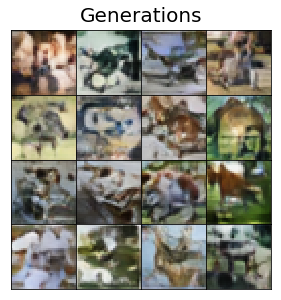

Epoch : 39  | Enc Loss : 588.13561 | Dec Loss : 7.29318 | Disc Loss : 1.56853


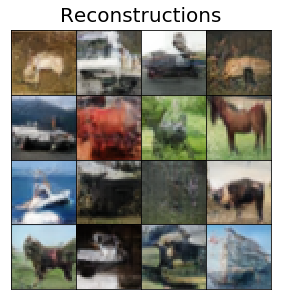

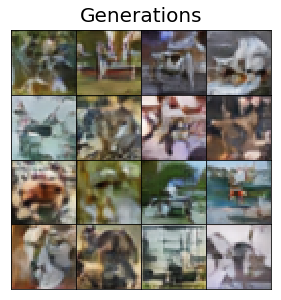

Epoch : 40  | Enc Loss : 588.53343 | Dec Loss : 7.33628 | Disc Loss : 1.57119


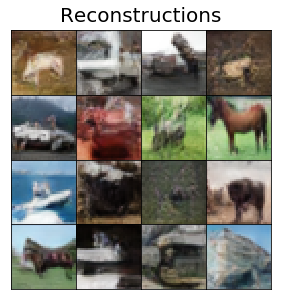

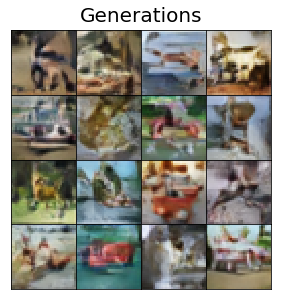

Epoch : 41  | Enc Loss : 587.67286 | Dec Loss : 7.36672 | Disc Loss : 1.56553


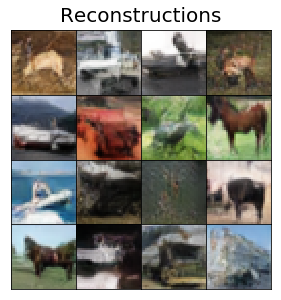

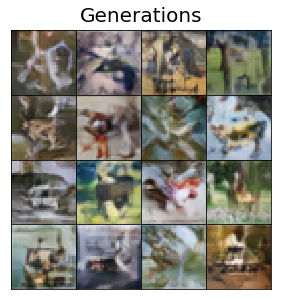

Epoch : 42  | Enc Loss : 587.49235 | Dec Loss : 7.31149 | Disc Loss : 1.56513


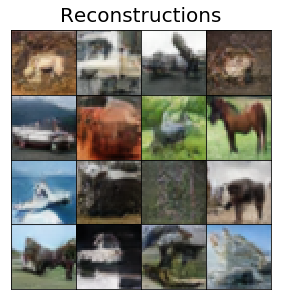

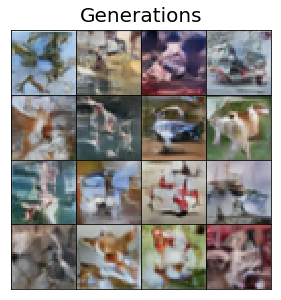

Epoch : 43  | Enc Loss : 587.35969 | Dec Loss : 7.33989 | Disc Loss : 1.56364


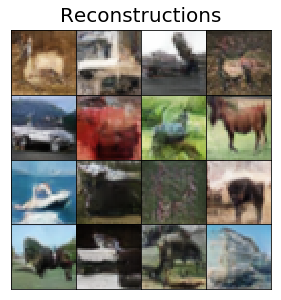

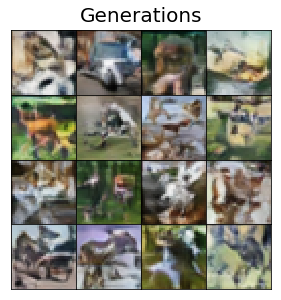

Epoch : 44  | Enc Loss : 587.13526 | Dec Loss : 7.30483 | Disc Loss : 1.56101


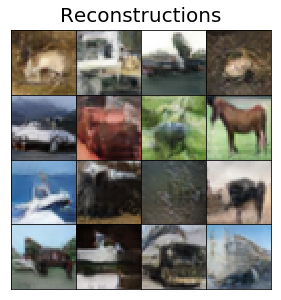

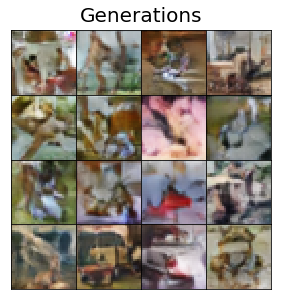

Epoch : 45  | Enc Loss : 587.31175 | Dec Loss : 7.32586 | Disc Loss : 1.56032


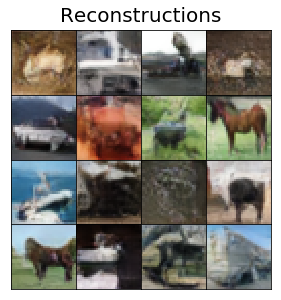

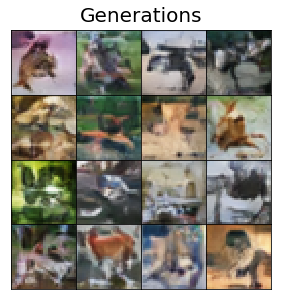

Epoch : 46  | Enc Loss : 587.11327 | Dec Loss : 7.35668 | Disc Loss : 1.55560


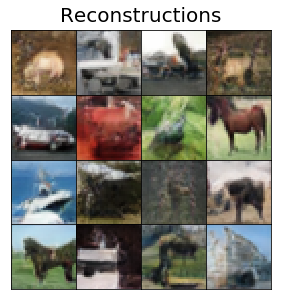

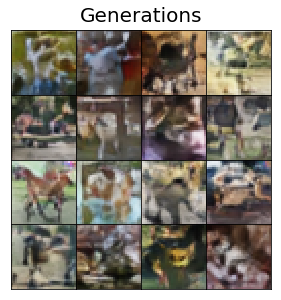

Epoch : 47  | Enc Loss : 586.78406 | Dec Loss : 7.35306 | Disc Loss : 1.55077


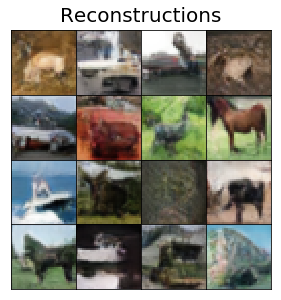

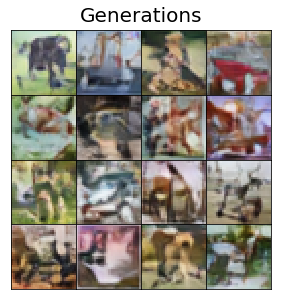

Epoch : 48  | Enc Loss : 587.04990 | Dec Loss : 7.38635 | Disc Loss : 1.55196


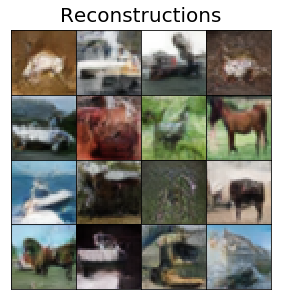

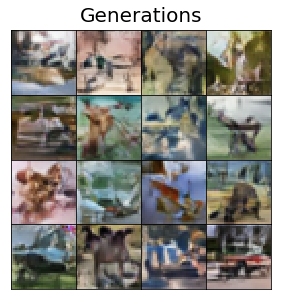

Epoch : 49  | Enc Loss : 586.67127 | Dec Loss : 7.36380 | Disc Loss : 1.54816


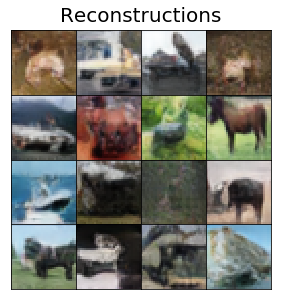

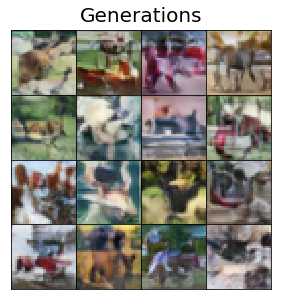

Epoch : 50  | Enc Loss : 585.52145 | Dec Loss : 7.37392 | Disc Loss : 1.54463


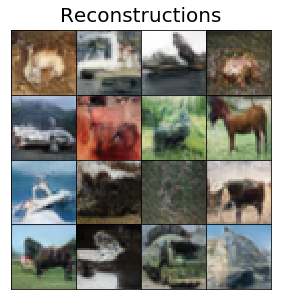

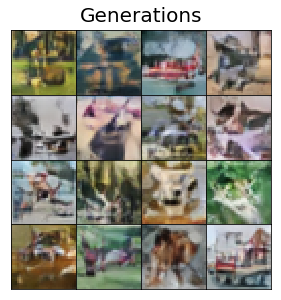

Epoch : 51  | Enc Loss : 586.58963 | Dec Loss : 7.37853 | Disc Loss : 1.54111


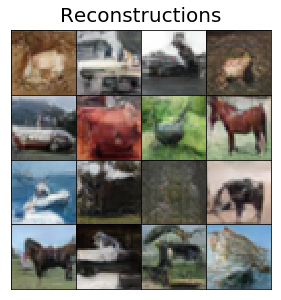

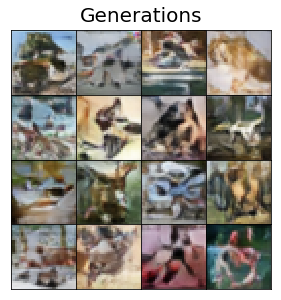

Epoch : 52  | Enc Loss : 586.23306 | Dec Loss : 7.38118 | Disc Loss : 1.54252


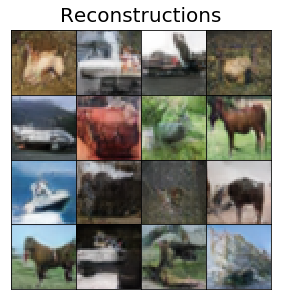

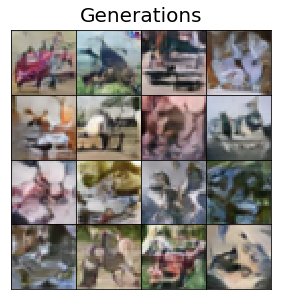

Epoch : 53  | Enc Loss : 586.12527 | Dec Loss : 7.36190 | Disc Loss : 1.53953


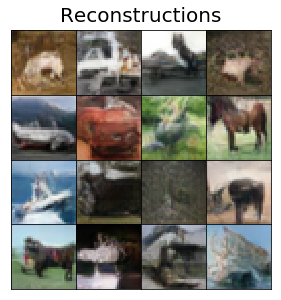

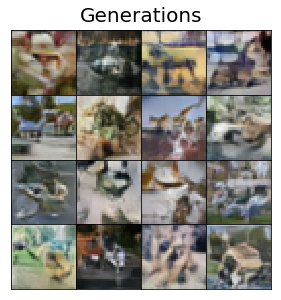

Epoch : 54  | Enc Loss : 585.07999 | Dec Loss : 7.37197 | Disc Loss : 1.53834


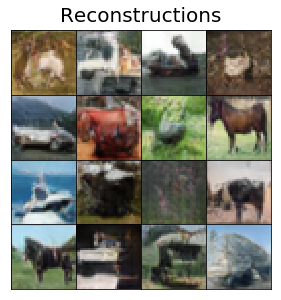

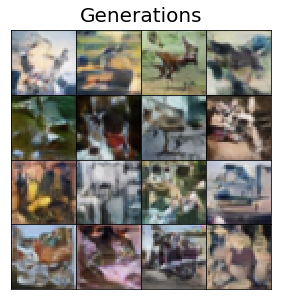

Epoch : 55  | Enc Loss : 585.18932 | Dec Loss : 7.39727 | Disc Loss : 1.54124


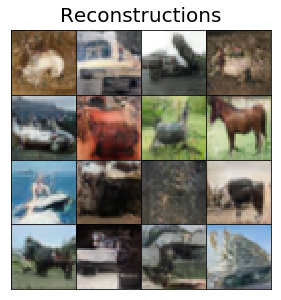

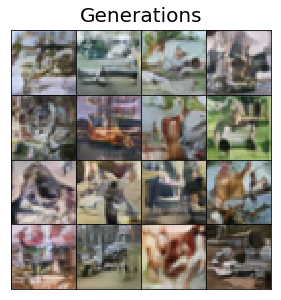

Epoch : 56  | Enc Loss : 586.36437 | Dec Loss : 7.39814 | Disc Loss : 1.53507


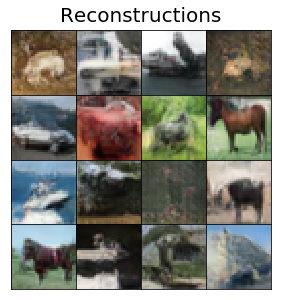

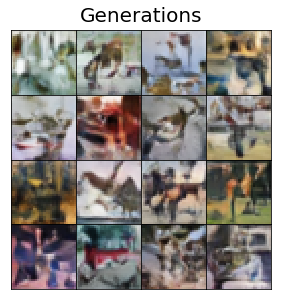

Epoch : 57  | Enc Loss : 586.36657 | Dec Loss : 7.40093 | Disc Loss : 1.53526


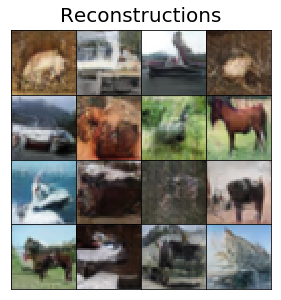

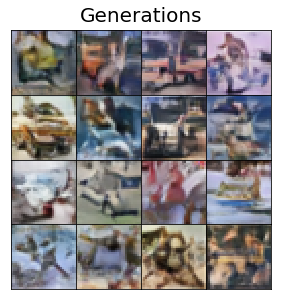

Epoch : 58  | Enc Loss : 585.12216 | Dec Loss : 7.42458 | Disc Loss : 1.53224


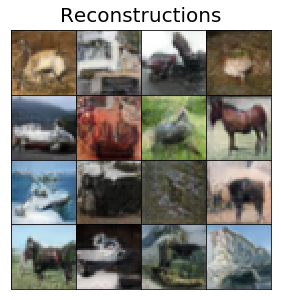

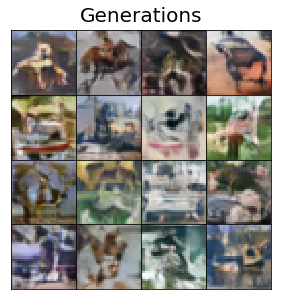

Epoch : 59  | Enc Loss : 585.14234 | Dec Loss : 7.42254 | Disc Loss : 1.53337


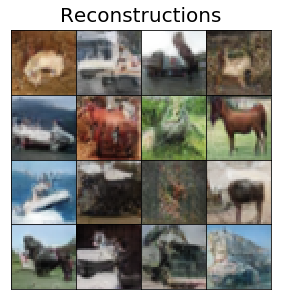

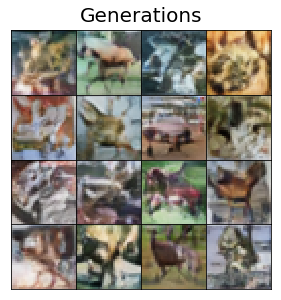

Epoch : 60  | Enc Loss : 584.21918 | Dec Loss : 7.40440 | Disc Loss : 1.52880


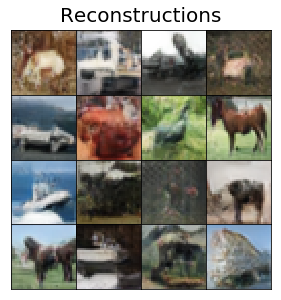

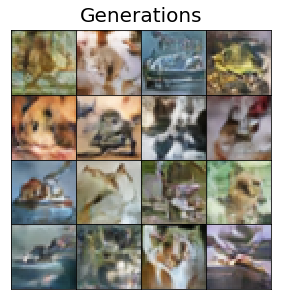

Epoch : 61  | Enc Loss : 583.47862 | Dec Loss : 7.45999 | Disc Loss : 1.52873


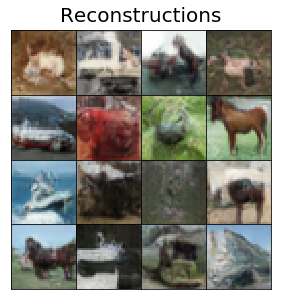

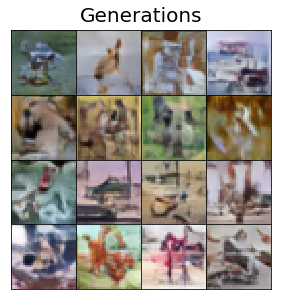

Epoch : 62  | Enc Loss : 582.71480 | Dec Loss : 7.43653 | Disc Loss : 1.52885


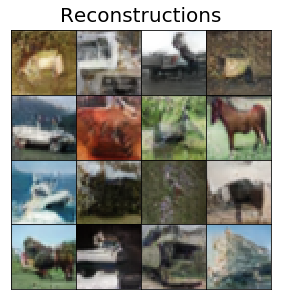

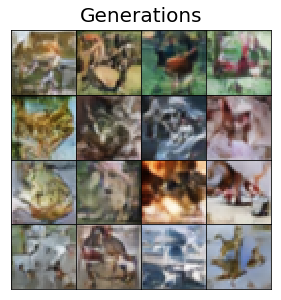

Epoch : 63  | Enc Loss : 582.58800 | Dec Loss : 7.42546 | Disc Loss : 1.53049


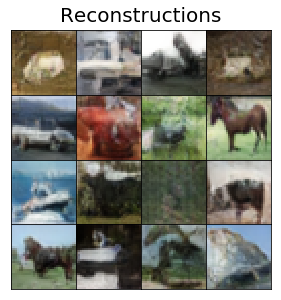

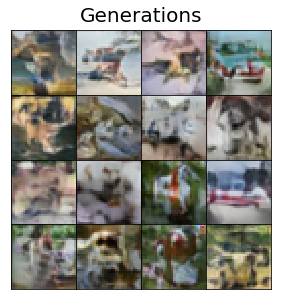

Epoch : 64  | Enc Loss : 584.03216 | Dec Loss : 7.45090 | Disc Loss : 1.52718


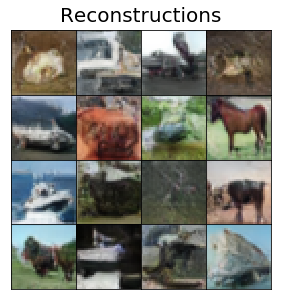

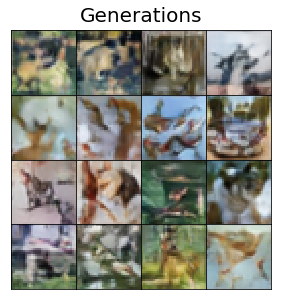

Epoch : 65  | Enc Loss : 584.86047 | Dec Loss : 7.47090 | Disc Loss : 1.52620


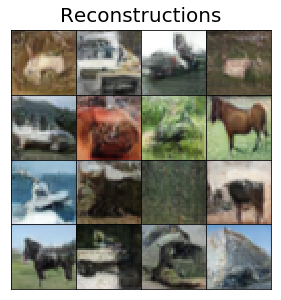

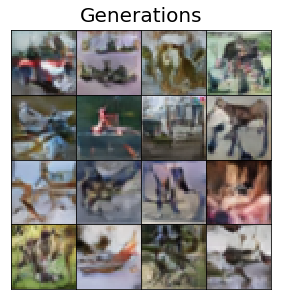

Epoch : 66  | Enc Loss : 584.47863 | Dec Loss : 7.47476 | Disc Loss : 1.52749


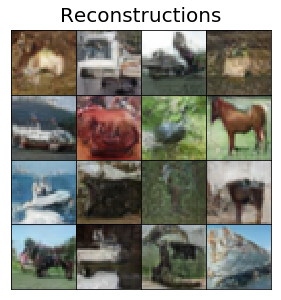

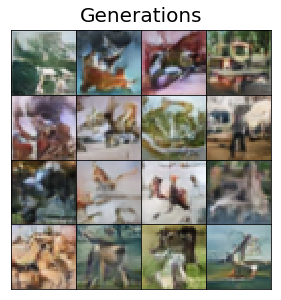

Epoch : 67  | Enc Loss : 583.87158 | Dec Loss : 7.43892 | Disc Loss : 1.52592


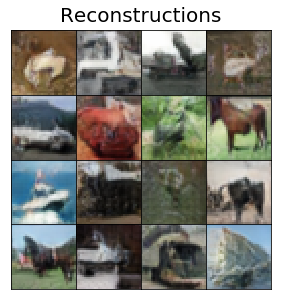

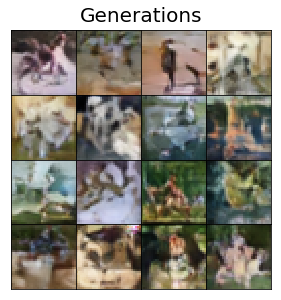

Epoch : 68  | Enc Loss : 582.72242 | Dec Loss : 7.48067 | Disc Loss : 1.53445


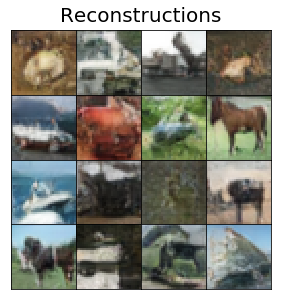

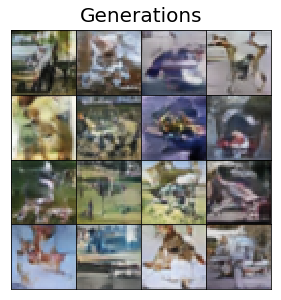

Epoch : 69  | Enc Loss : 582.66151 | Dec Loss : 7.47711 | Disc Loss : 1.52673


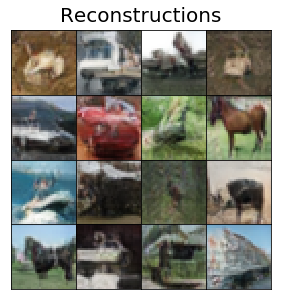

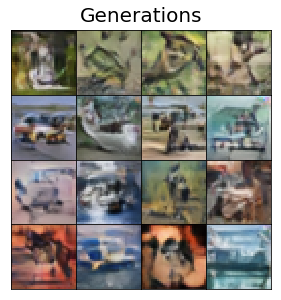

Epoch : 70  | Enc Loss : 583.37861 | Dec Loss : 7.49364 | Disc Loss : 1.53098


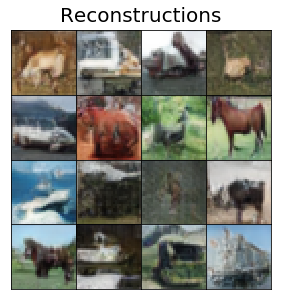

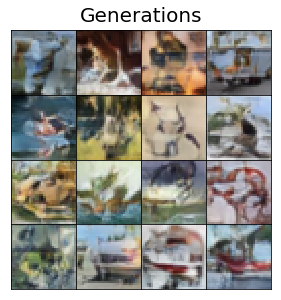

Epoch : 71  | Enc Loss : 582.31353 | Dec Loss : 7.48779 | Disc Loss : 1.52847


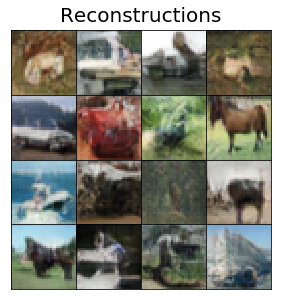

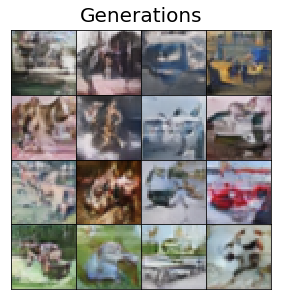

Epoch : 72  | Enc Loss : 583.37329 | Dec Loss : 7.47784 | Disc Loss : 1.52857


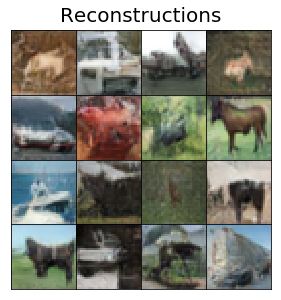

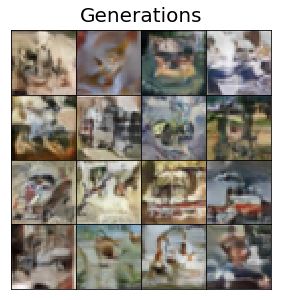

Epoch : 73  | Enc Loss : 582.25684 | Dec Loss : 7.47115 | Disc Loss : 1.53008


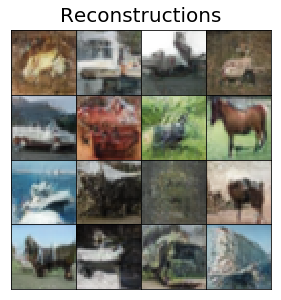

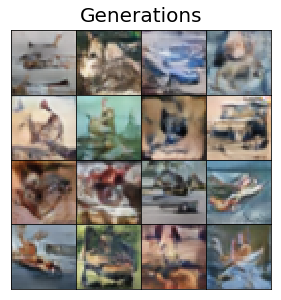

Epoch : 74  | Enc Loss : 581.25450 | Dec Loss : 7.47935 | Disc Loss : 1.53027


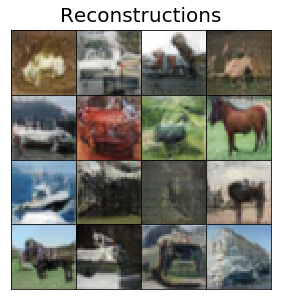

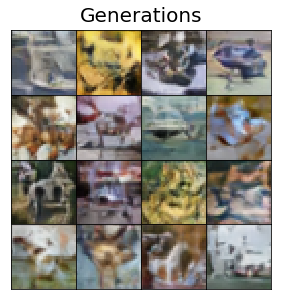

Epoch : 75  | Enc Loss : 580.58607 | Dec Loss : 7.47270 | Disc Loss : 1.53056


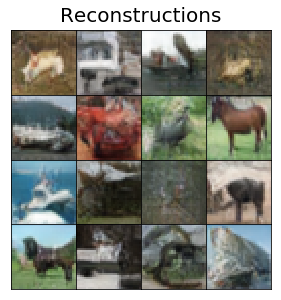

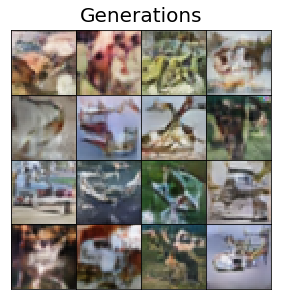

Epoch : 76  | Enc Loss : 580.33692 | Dec Loss : 7.50995 | Disc Loss : 1.52832


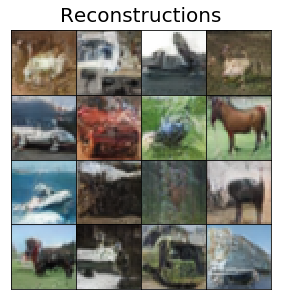

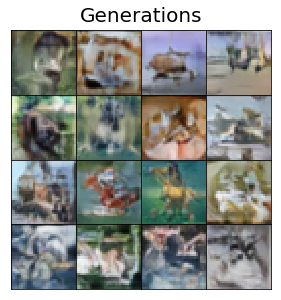

Epoch : 77  | Enc Loss : 580.31868 | Dec Loss : 7.51216 | Disc Loss : 1.53197


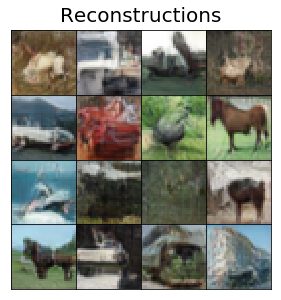

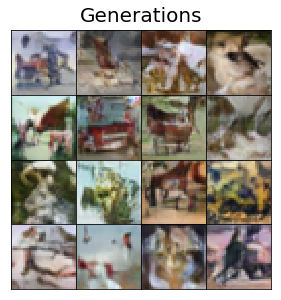

Epoch : 78  | Enc Loss : 580.26621 | Dec Loss : 7.51988 | Disc Loss : 1.53187


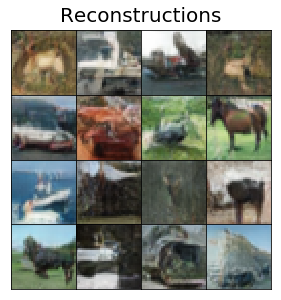

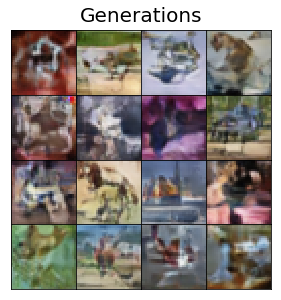

Epoch : 79  | Enc Loss : 580.17780 | Dec Loss : 7.52176 | Disc Loss : 1.53216


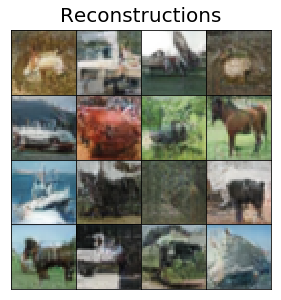

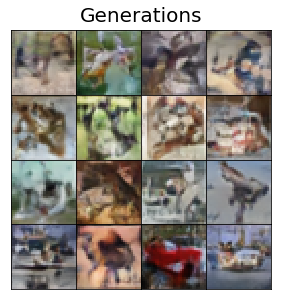

Epoch : 80  | Enc Loss : 581.28968 | Dec Loss : 7.50408 | Disc Loss : 1.52775


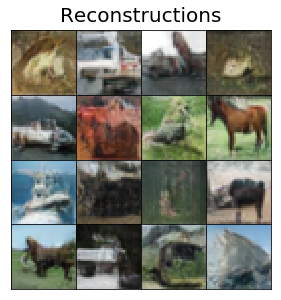

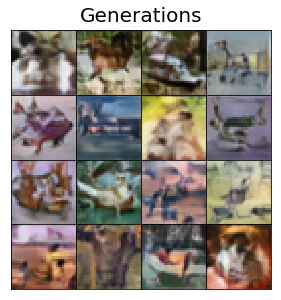

Epoch : 81  | Enc Loss : 580.14935 | Dec Loss : 7.47498 | Disc Loss : 1.53049


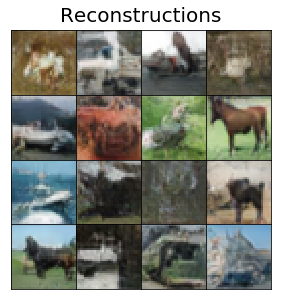

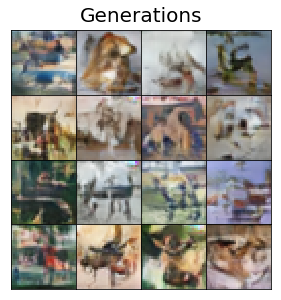

Epoch : 82  | Enc Loss : 580.74036 | Dec Loss : 7.52135 | Disc Loss : 1.52926


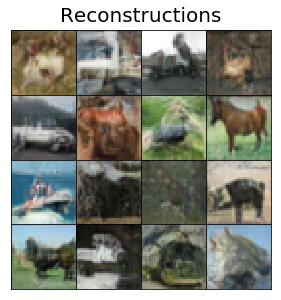

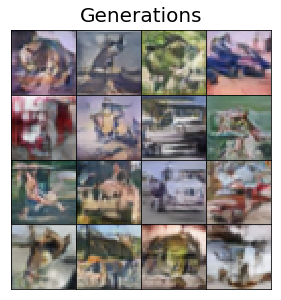

Epoch : 83  | Enc Loss : 579.70903 | Dec Loss : 7.52089 | Disc Loss : 1.52955


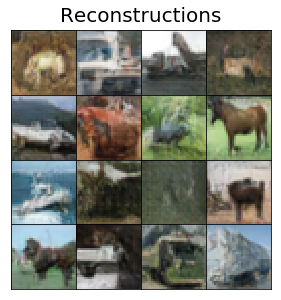

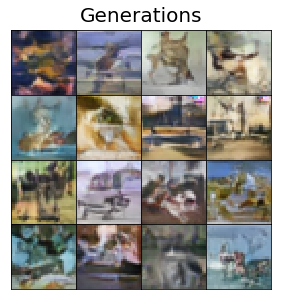

Epoch : 84  | Enc Loss : 578.70848 | Dec Loss : 7.48421 | Disc Loss : 1.52869


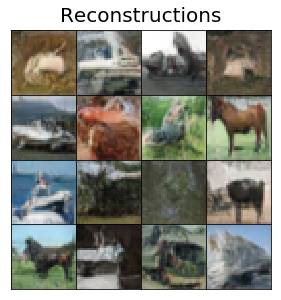

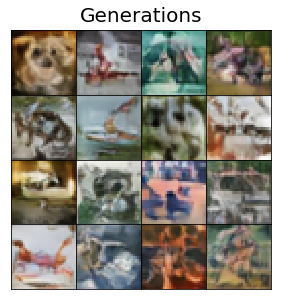

Epoch : 85  | Enc Loss : 578.51866 | Dec Loss : 7.48915 | Disc Loss : 1.52512


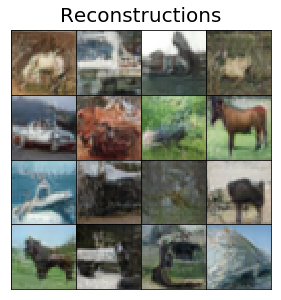

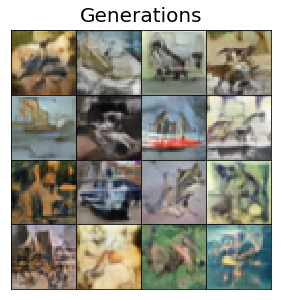

Epoch : 86  | Enc Loss : 580.20632 | Dec Loss : 7.47191 | Disc Loss : 1.53009


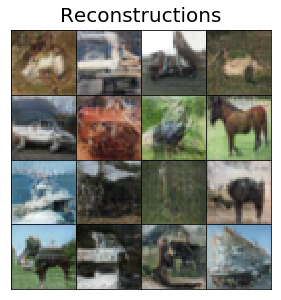

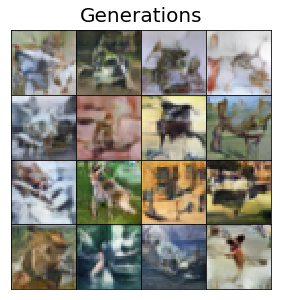

Epoch : 87  | Enc Loss : 580.69979 | Dec Loss : 7.50209 | Disc Loss : 1.52811


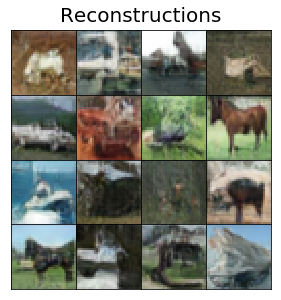

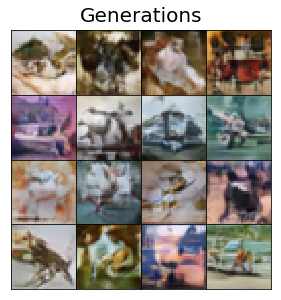

Epoch : 88  | Enc Loss : 579.99549 | Dec Loss : 7.49438 | Disc Loss : 1.52940


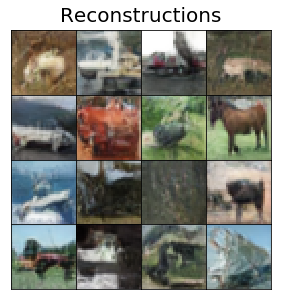

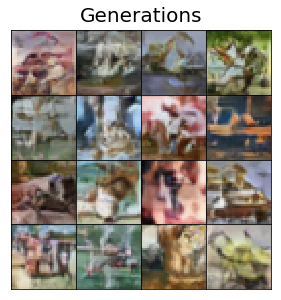

Epoch : 89  | Enc Loss : 579.18335 | Dec Loss : 7.50586 | Disc Loss : 1.52635


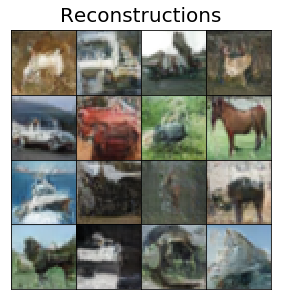

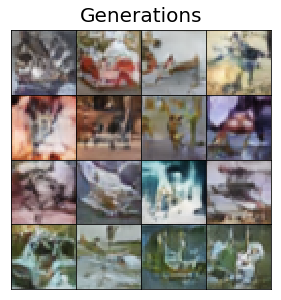

Epoch : 90  | Enc Loss : 578.36157 | Dec Loss : 7.53027 | Disc Loss : 1.53202


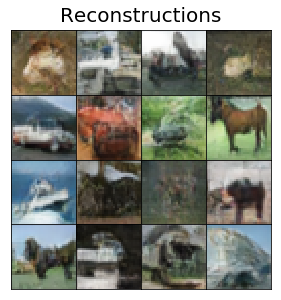

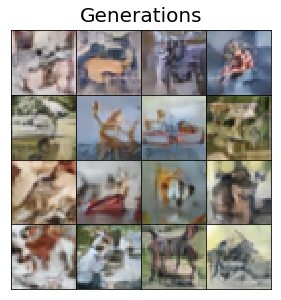

Epoch : 91  | Enc Loss : 578.01106 | Dec Loss : 7.53480 | Disc Loss : 1.53031


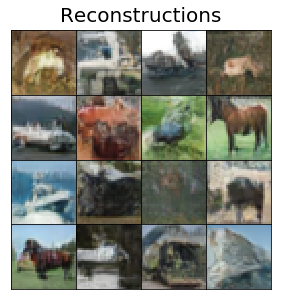

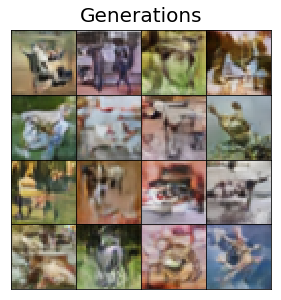

Epoch : 92  | Enc Loss : 577.59197 | Dec Loss : 7.48918 | Disc Loss : 1.53250


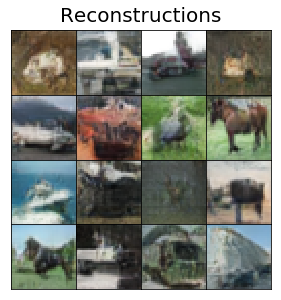

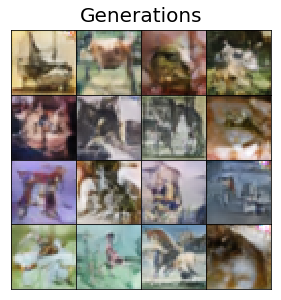

Epoch : 93  | Enc Loss : 576.76417 | Dec Loss : 7.50900 | Disc Loss : 1.53099


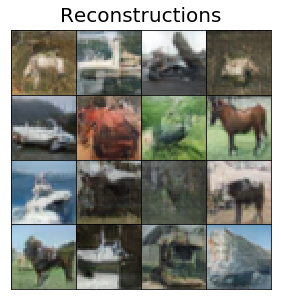

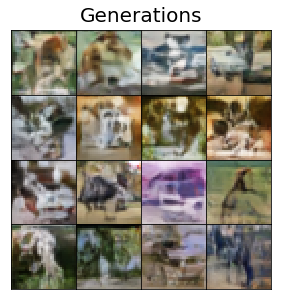

Epoch : 94  | Enc Loss : 576.89844 | Dec Loss : 7.50426 | Disc Loss : 1.53155


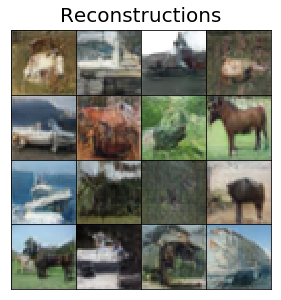

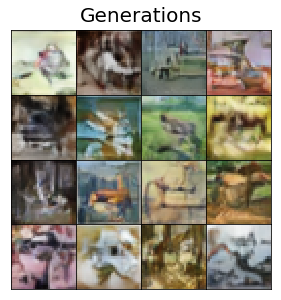

Epoch : 95  | Enc Loss : 575.54398 | Dec Loss : 7.52741 | Disc Loss : 1.52873


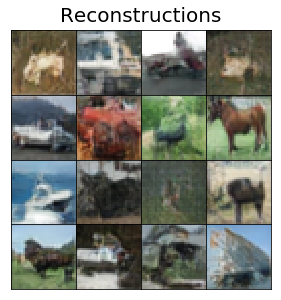

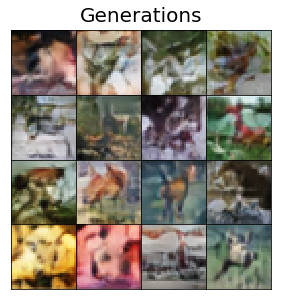

Epoch : 96  | Enc Loss : 575.50137 | Dec Loss : 7.55681 | Disc Loss : 1.52851


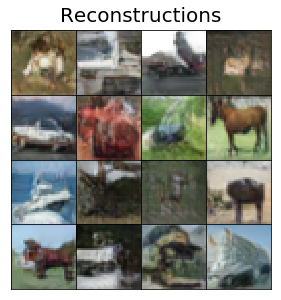

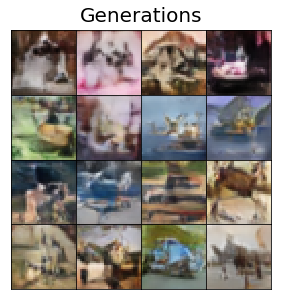

Epoch : 97  | Enc Loss : 574.12752 | Dec Loss : 7.53481 | Disc Loss : 1.52494


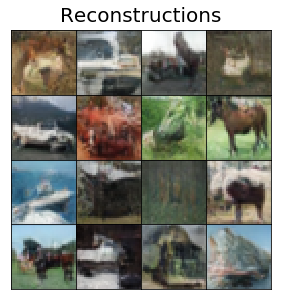

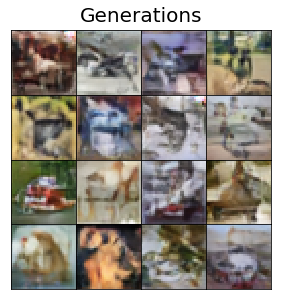

Epoch : 98  | Enc Loss : 573.35767 | Dec Loss : 7.48943 | Disc Loss : 1.52825


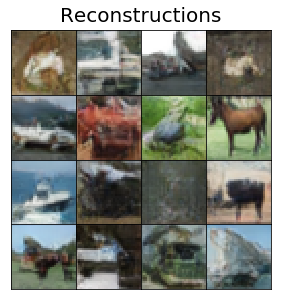

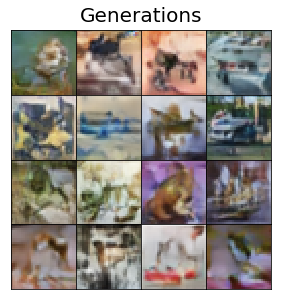

Epoch : 99  | Enc Loss : 572.77755 | Dec Loss : 7.51368 | Disc Loss : 1.52457


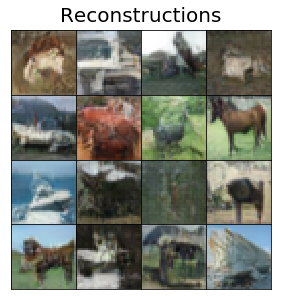

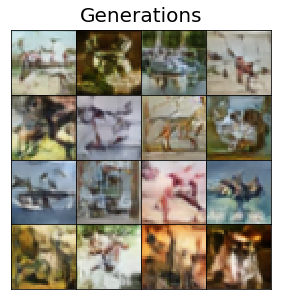

Epoch : 100 | Enc Loss : 572.56637 | Dec Loss : 7.49465 | Disc Loss : 1.52459


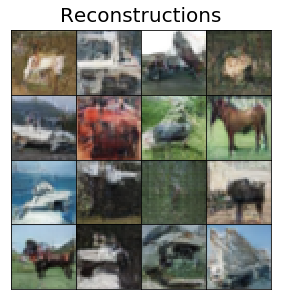

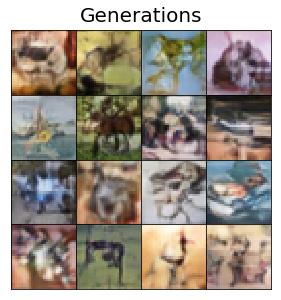

Epoch : 101 | Enc Loss : 572.20670 | Dec Loss : 7.52308 | Disc Loss : 1.52601


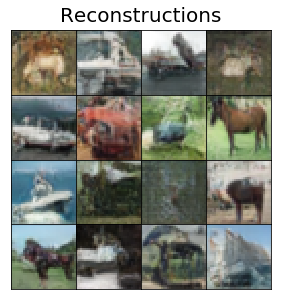

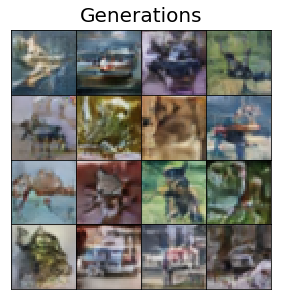

Epoch : 102 | Enc Loss : 573.34175 | Dec Loss : 7.56612 | Disc Loss : 1.52331


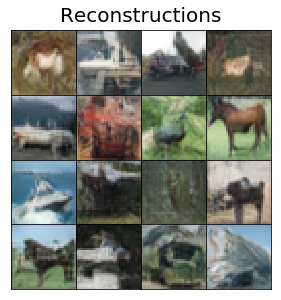

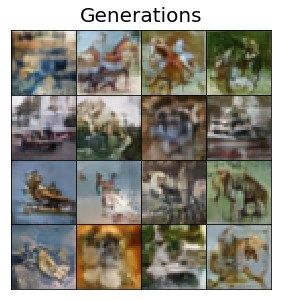

Epoch : 103 | Enc Loss : 572.64676 | Dec Loss : 7.53931 | Disc Loss : 1.52093


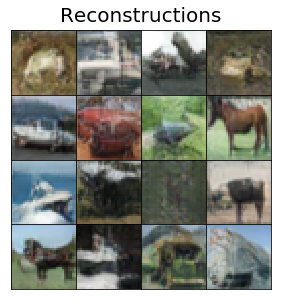

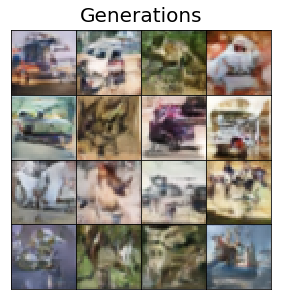

Epoch : 104 | Enc Loss : 571.65599 | Dec Loss : 7.47383 | Disc Loss : 1.52465


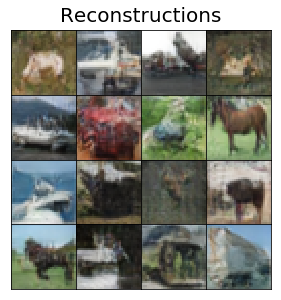

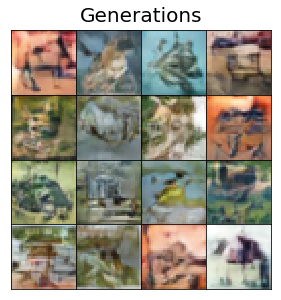

Epoch : 105 | Enc Loss : 571.98194 | Dec Loss : 7.50262 | Disc Loss : 1.52564


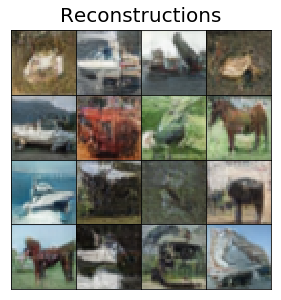

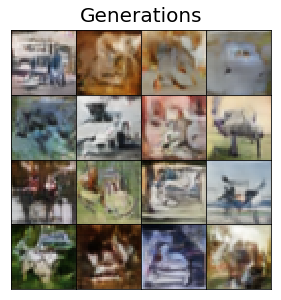

Epoch : 106 | Enc Loss : 570.78348 | Dec Loss : 7.51979 | Disc Loss : 1.52111


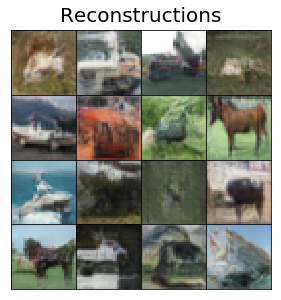

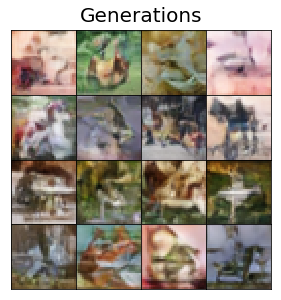

Epoch : 107 | Enc Loss : 571.56996 | Dec Loss : 7.50990 | Disc Loss : 1.52266


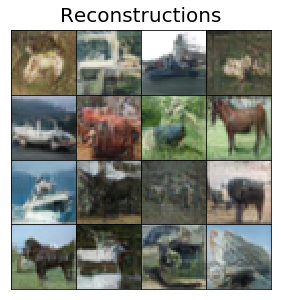

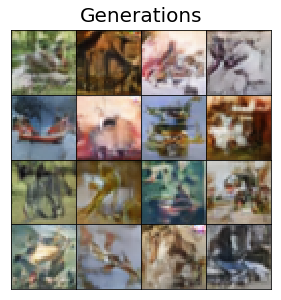

Epoch : 108 | Enc Loss : 571.41332 | Dec Loss : 7.50134 | Disc Loss : 1.51658


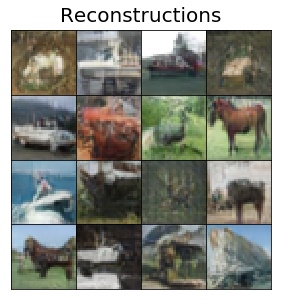

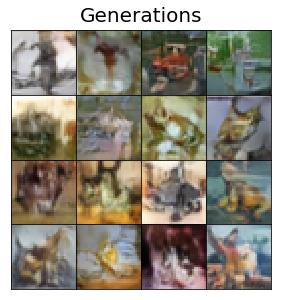

Epoch : 109 | Enc Loss : 570.63158 | Dec Loss : 7.49723 | Disc Loss : 1.51804


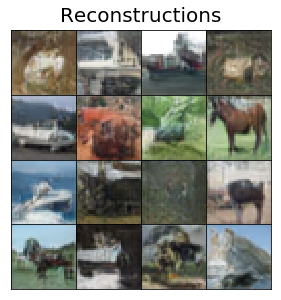

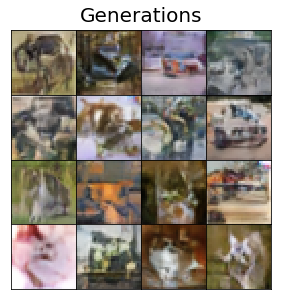

Epoch : 110 | Enc Loss : 569.88937 | Dec Loss : 7.52453 | Disc Loss : 1.51400


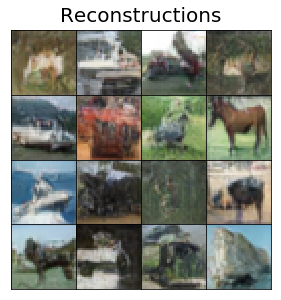

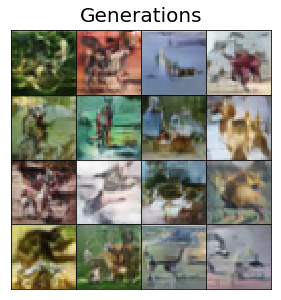

Epoch : 111 | Enc Loss : 569.78848 | Dec Loss : 7.49034 | Disc Loss : 1.51697


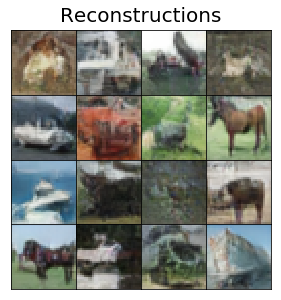

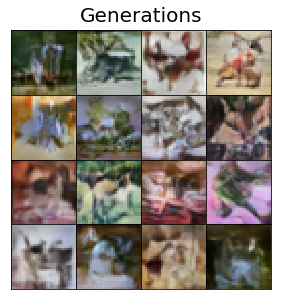

Epoch : 112 | Enc Loss : 570.23972 | Dec Loss : 7.48229 | Disc Loss : 1.51298


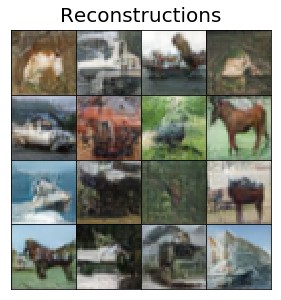

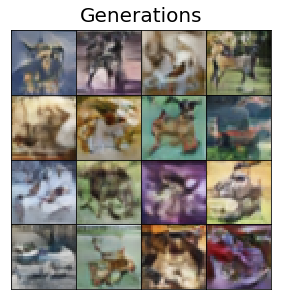

Epoch : 113 | Enc Loss : 570.30232 | Dec Loss : 7.51570 | Disc Loss : 1.50931


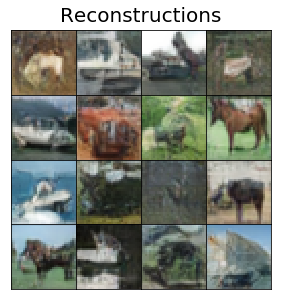

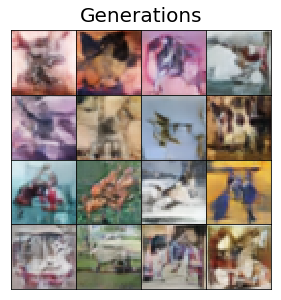

Epoch : 114 | Enc Loss : 569.20146 | Dec Loss : 7.52071 | Disc Loss : 1.51401


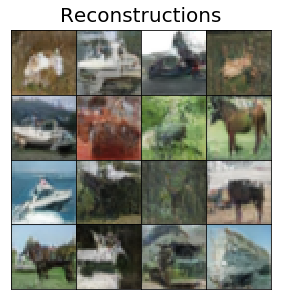

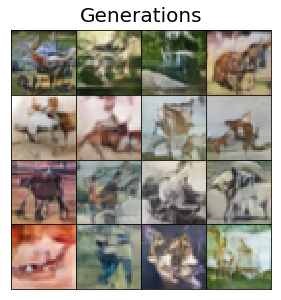

Epoch : 115 | Enc Loss : 569.16846 | Dec Loss : 7.51307 | Disc Loss : 1.51252


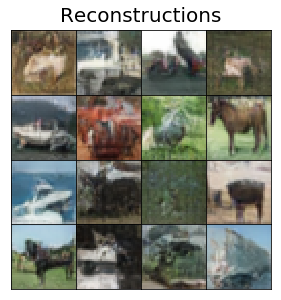

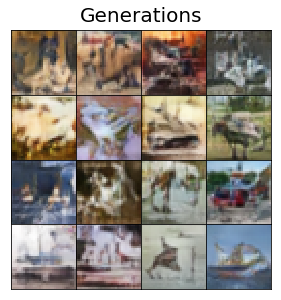

Epoch : 116 | Enc Loss : 570.31797 | Dec Loss : 7.52623 | Disc Loss : 1.50757


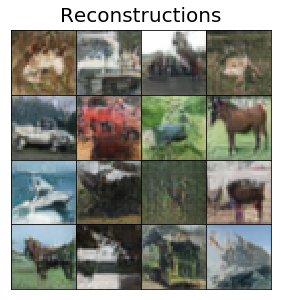

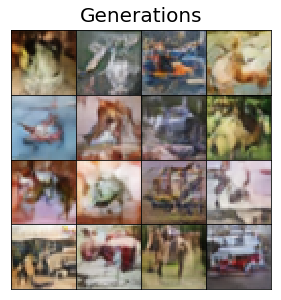

Epoch : 117 | Enc Loss : 570.72596 | Dec Loss : 7.53296 | Disc Loss : 1.51203


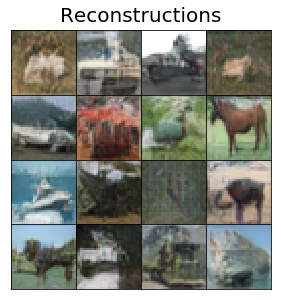

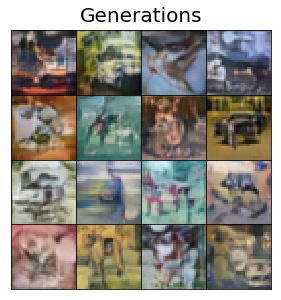

Epoch : 118 | Enc Loss : 571.66408 | Dec Loss : 7.57925 | Disc Loss : 1.50818


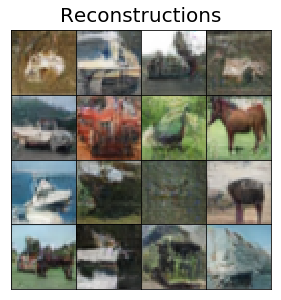

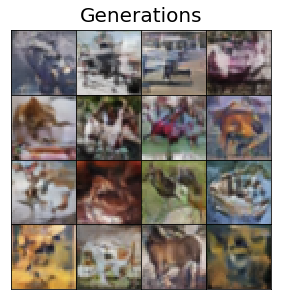

Epoch : 119 | Enc Loss : 572.17517 | Dec Loss : 7.52837 | Disc Loss : 1.50825


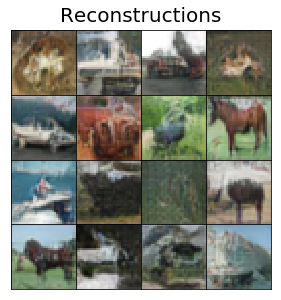

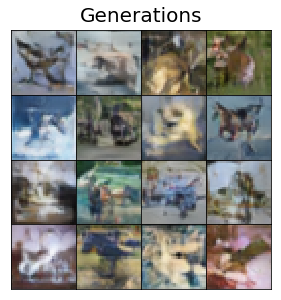

Epoch : 120 | Enc Loss : 571.00450 | Dec Loss : 7.55476 | Disc Loss : 1.50669


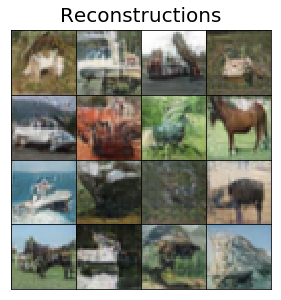

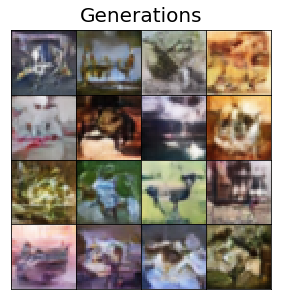

Epoch : 121 | Enc Loss : 571.02476 | Dec Loss : 7.57736 | Disc Loss : 1.50762


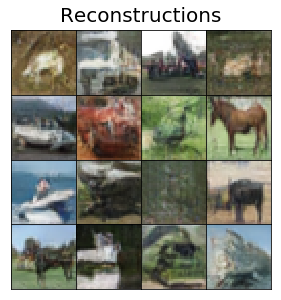

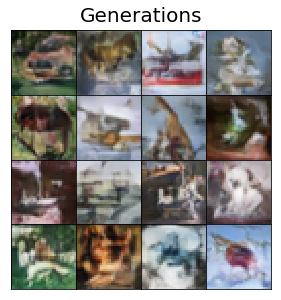

Epoch : 122 | Enc Loss : 572.60048 | Dec Loss : 7.55992 | Disc Loss : 1.50165


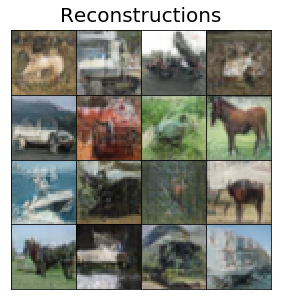

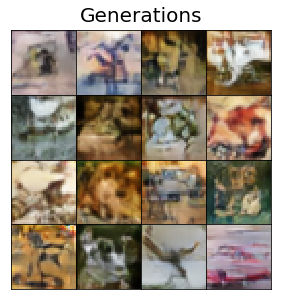

Epoch : 123 | Enc Loss : 572.50881 | Dec Loss : 7.57272 | Disc Loss : 1.50283


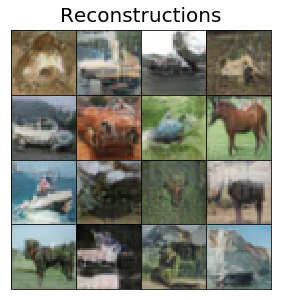

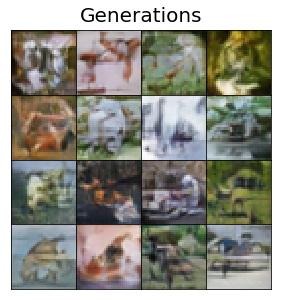

Epoch : 124 | Enc Loss : 571.98979 | Dec Loss : 7.54273 | Disc Loss : 1.49956


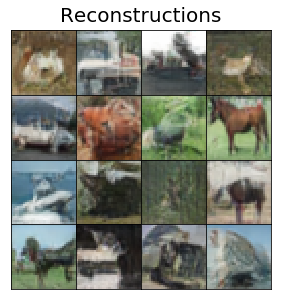

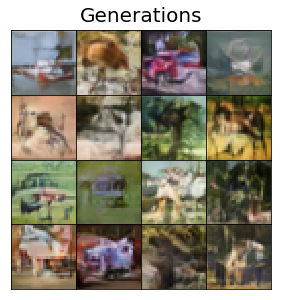

Epoch : 125 | Enc Loss : 570.66254 | Dec Loss : 7.55621 | Disc Loss : 1.50141


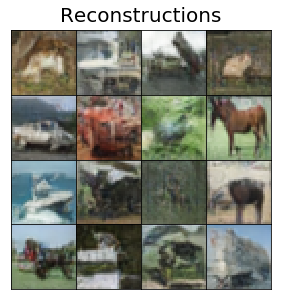

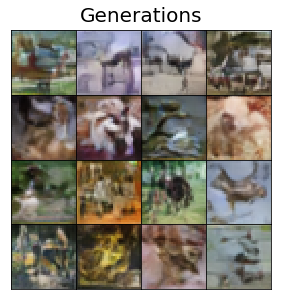

Epoch : 126 | Enc Loss : 572.36140 | Dec Loss : 7.55236 | Disc Loss : 1.49622


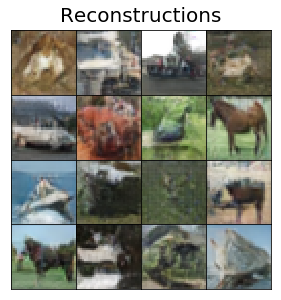

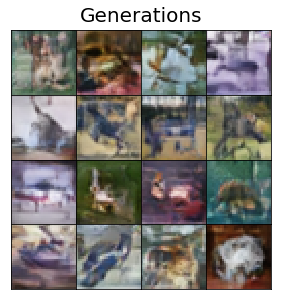

Epoch : 127 | Enc Loss : 571.37853 | Dec Loss : 7.57119 | Disc Loss : 1.50083


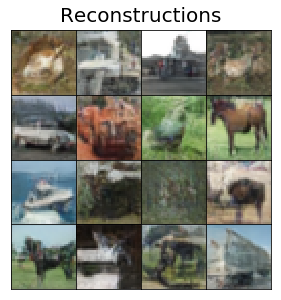

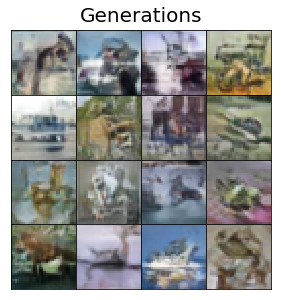

Epoch : 128 | Enc Loss : 568.83757 | Dec Loss : 7.53039 | Disc Loss : 1.49796


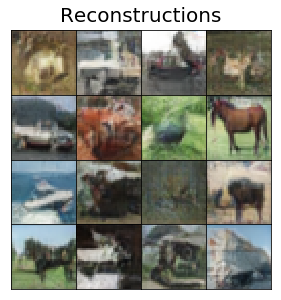

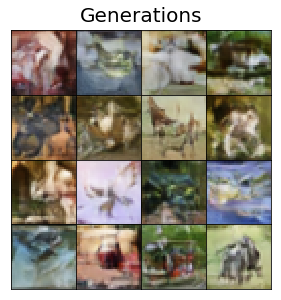

Epoch : 129 | Enc Loss : 568.33766 | Dec Loss : 7.54807 | Disc Loss : 1.49672


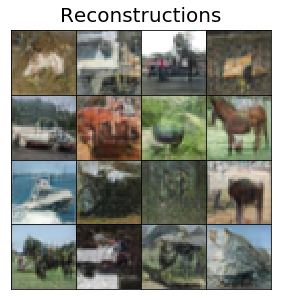

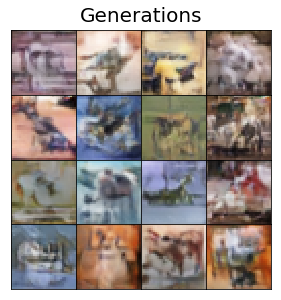

Epoch : 130 | Enc Loss : 568.86226 | Dec Loss : 7.50694 | Disc Loss : 1.50138


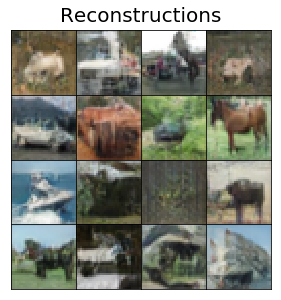

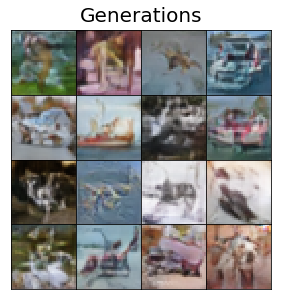

Epoch : 131 | Enc Loss : 569.48323 | Dec Loss : 7.56629 | Disc Loss : 1.49616


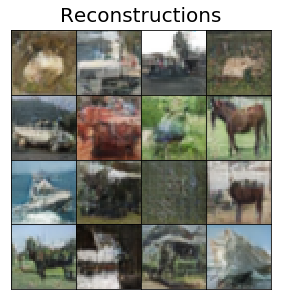

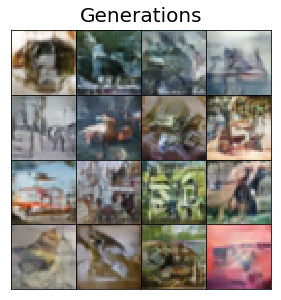

Epoch : 132 | Enc Loss : 569.15951 | Dec Loss : 7.57230 | Disc Loss : 1.49840


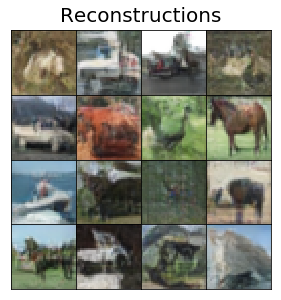

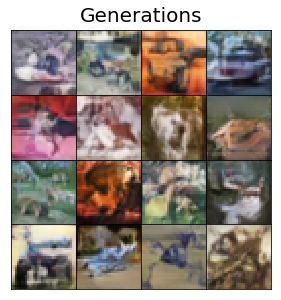

Epoch : 133 | Enc Loss : 567.27788 | Dec Loss : 7.52059 | Disc Loss : 1.49812


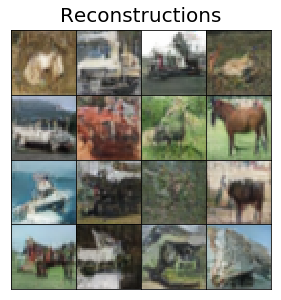

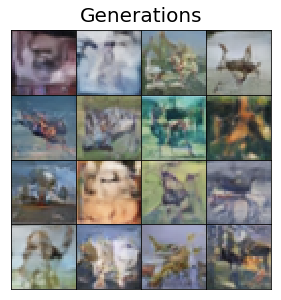

Epoch : 134 | Enc Loss : 567.13447 | Dec Loss : 7.54661 | Disc Loss : 1.49534


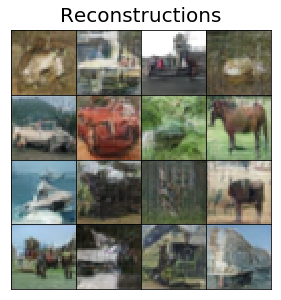

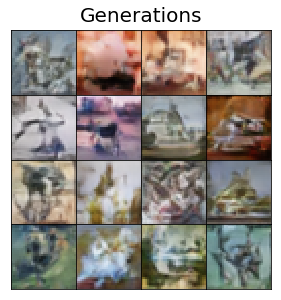

Epoch : 135 | Enc Loss : 566.41403 | Dec Loss : 7.53622 | Disc Loss : 1.49416


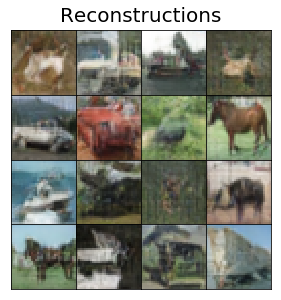

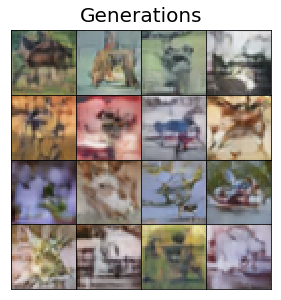

Epoch : 136 | Enc Loss : 566.15832 | Dec Loss : 7.51761 | Disc Loss : 1.49738


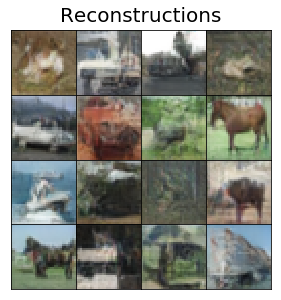

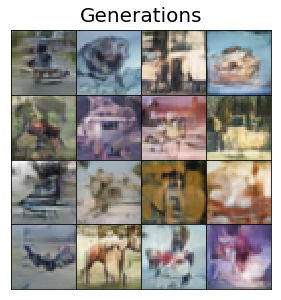

Epoch : 137 | Enc Loss : 565.56185 | Dec Loss : 7.51687 | Disc Loss : 1.49894


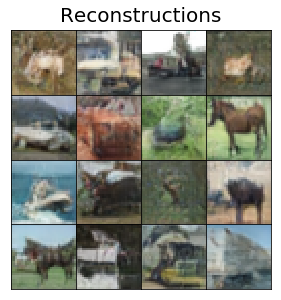

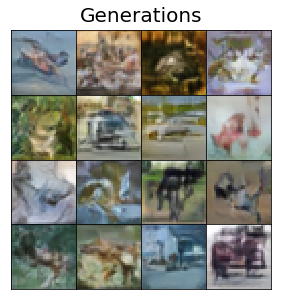

Epoch : 138 | Enc Loss : 565.08146 | Dec Loss : 7.57236 | Disc Loss : 1.49450


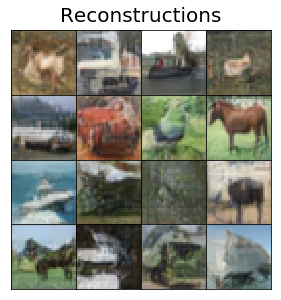

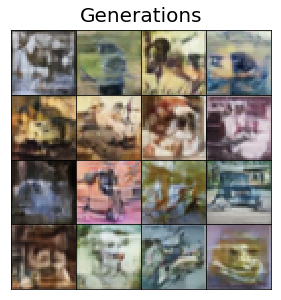

Epoch : 139 | Enc Loss : 564.92298 | Dec Loss : 7.47011 | Disc Loss : 1.49131


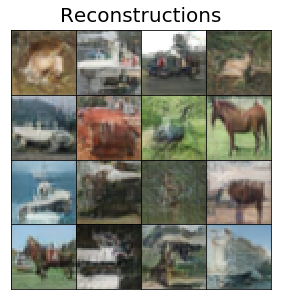

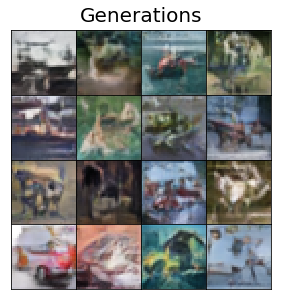

Epoch : 140 | Enc Loss : 564.79518 | Dec Loss : 7.54851 | Disc Loss : 1.49489


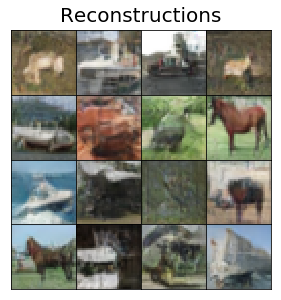

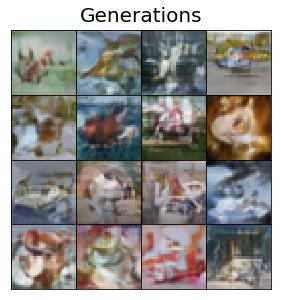

Epoch : 141 | Enc Loss : 564.48826 | Dec Loss : 7.54761 | Disc Loss : 1.49325


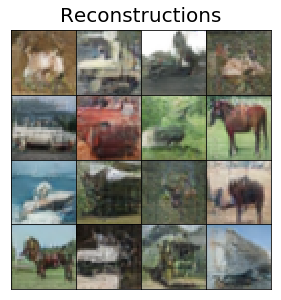

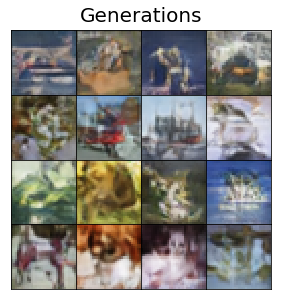

Epoch : 142 | Enc Loss : 564.25757 | Dec Loss : 7.54184 | Disc Loss : 1.48745


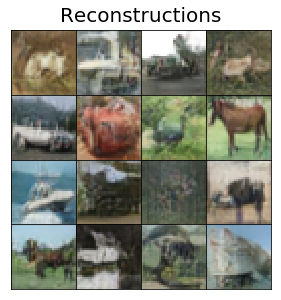

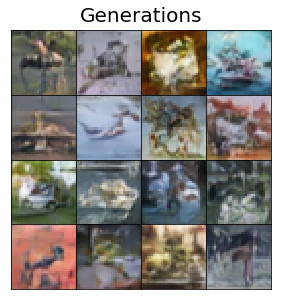

Epoch : 143 | Enc Loss : 564.68462 | Dec Loss : 7.53951 | Disc Loss : 1.48588


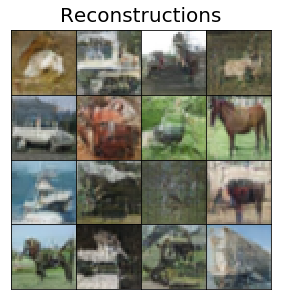

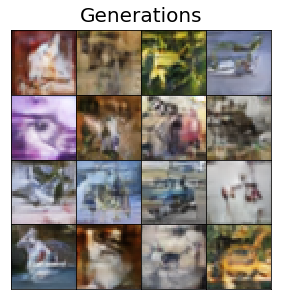

Epoch : 144 | Enc Loss : 563.60621 | Dec Loss : 7.56068 | Disc Loss : 1.48672


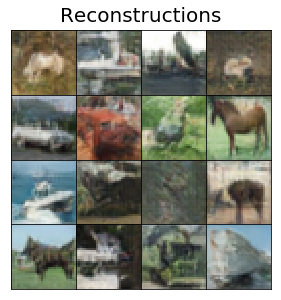

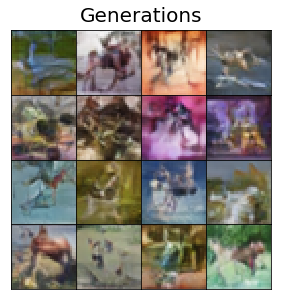

Epoch : 145 | Enc Loss : 564.09659 | Dec Loss : 7.53462 | Disc Loss : 1.49039


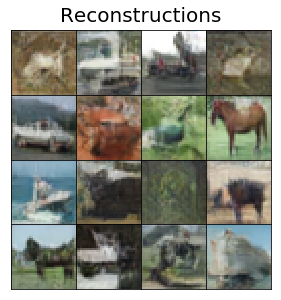

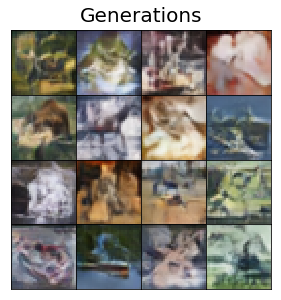

Epoch : 146 | Enc Loss : 564.57658 | Dec Loss : 7.54416 | Disc Loss : 1.48576


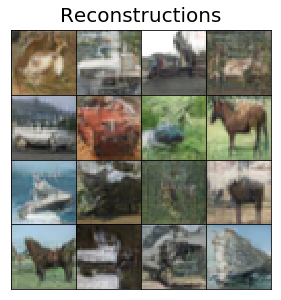

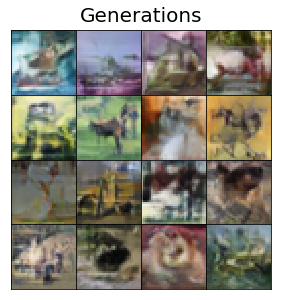

Epoch : 147 | Enc Loss : 564.48050 | Dec Loss : 7.55049 | Disc Loss : 1.48128


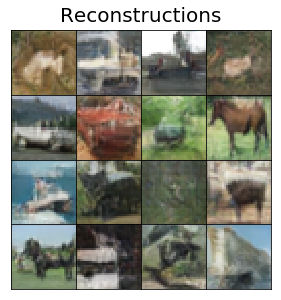

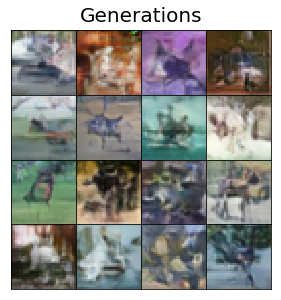

Epoch : 148 | Enc Loss : 563.79972 | Dec Loss : 7.55982 | Disc Loss : 1.48053


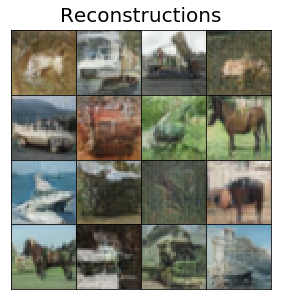

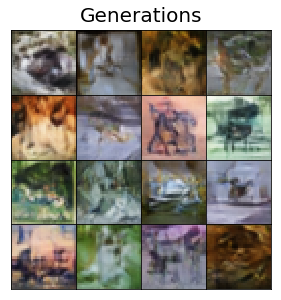

Epoch : 149 | Enc Loss : 562.83377 | Dec Loss : 7.54485 | Disc Loss : 1.47730


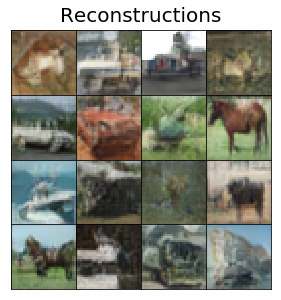

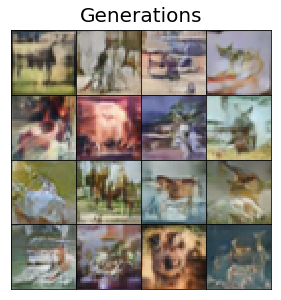

Epoch : 150 | Enc Loss : 563.45550 | Dec Loss : 7.52855 | Disc Loss : 1.48542


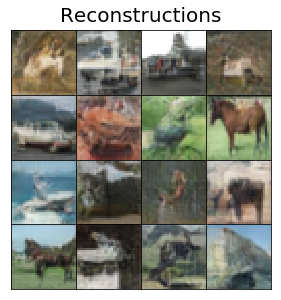

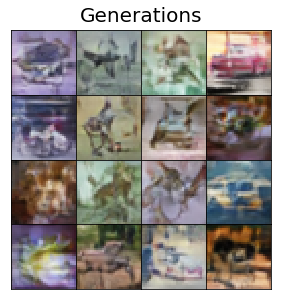

In [4]:
tf.reset_default_graph()

vae_gan = CIFAR_VAE_GAN('tf_logs/exp3/vae-gan/data_test/', lmda=1e-2, zdim=128, learning_rate=2e-4, beta1=0.0, beta2=0.9)

sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())

trainer = VAE_GAN_Trainer(sess, vae_gan, data_train, n_dis=5)
trainer.train(150, p_epochs=1)

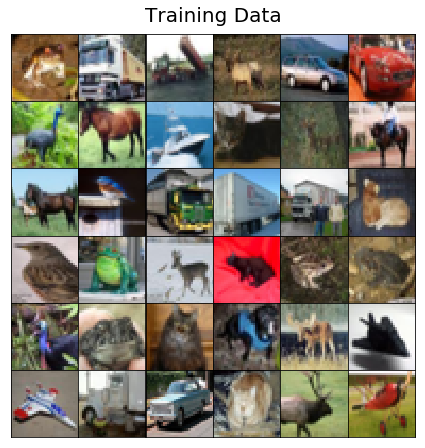

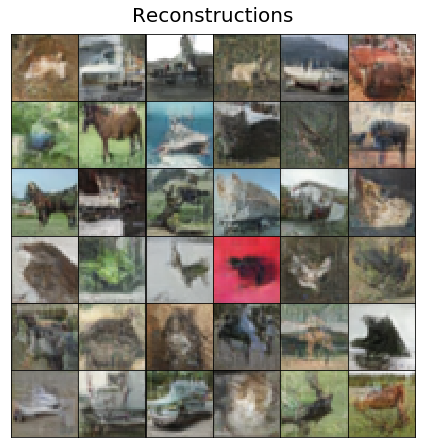

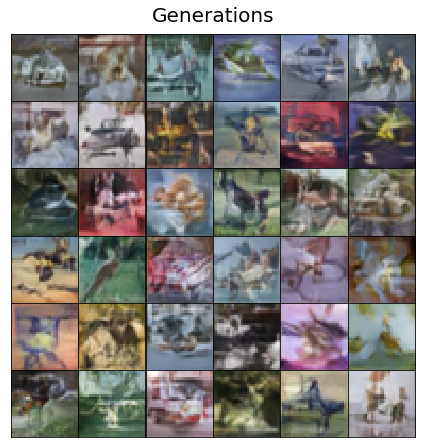

In [24]:
plt.figure(figsize=(6,6))
        
for i in range(36):
    
    image = (data_train[0][i] + 1) * 0.5

    plt.subplot(6, 6, i + 1)
    plt.imshow(image.reshape(32, 32, 3))
    plt.xticks([])
    plt.yticks([])

plt.suptitle('Training Data', fontsize=20, y=1.03)
plt.tight_layout()
plt.subplots_adjust(wspace=0.0, hspace=0.0)

plt.show()
plt.close()

data_rec = vae_gan.reconstruct(sess, (data_train[0][:36],0))

plt.figure(figsize=(6,6))
        
for i in range(36):
    
    image = (data_rec[i] + 1) * 0.5

    plt.subplot(6, 6, i + 1)
    plt.imshow(image.reshape(32, 32, 3))
    plt.xticks([])
    plt.yticks([])

plt.suptitle('Reconstructions', fontsize=20, y=1.03)
plt.tight_layout()
plt.subplots_adjust(wspace=0.0, hspace=0.0)

plt.show()
plt.close()

data_gen = vae_gan.generate(sess, 36)

plt.figure(figsize=(6,6))
        
for i in range(36):
    
    image = (data_gen[i] + 1) * 0.5

    plt.subplot(6, 6, i + 1)
    plt.imshow(image.reshape(32, 32, 3))
    plt.xticks([])
    plt.yticks([])

plt.suptitle('Generations', fontsize=20, y=1.03)
plt.tight_layout()
plt.subplots_adjust(wspace=0.0, hspace=0.0)

plt.show()
plt.close()